In [1]:
# Import necessary packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import seaborn as sns
sns.set()

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
file_path="/content/drive/MyDrive/NORMAL"

In [4]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 30.71 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


In [5]:
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


In [6]:
# Read csv file containing training datadata
train_df = pd.read_csv("nih/train-small.csv")
# Print first 5 rows
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
train_df.head()

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


In [7]:
# Look at the data type of each column and whether null values are present
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

In [8]:
print(f"The total patient ids are {train_df['PatientId'].count()}, from those the unique ids are {train_df['PatientId'].value_counts().shape[0]} ")

The total patient ids are 1000, from those the unique ids are 928 


In [9]:
columns = train_df.keys()
columns = list(columns)
print(columns)

['Image', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'PatientId', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [10]:
# Remove unnecesary elements
columns.remove('Image')
columns.remove('PatientId')
# Get the total classes
print(f"There are {len(columns)} columns of labels for these conditions: {columns}")

There are 14 columns of labels for these conditions: ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [11]:
# Print out the number of positive labels for each class
for column in columns:
    print(f"The class {column} has {train_df[column].sum()} samples")

The class Atelectasis has 106 samples
The class Cardiomegaly has 20 samples
The class Consolidation has 33 samples
The class Edema has 16 samples
The class Effusion has 128 samples
The class Emphysema has 13 samples
The class Fibrosis has 14 samples
The class Hernia has 2 samples
The class Infiltration has 175 samples
The class Mass has 45 samples
The class Nodule has 54 samples
The class Pleural_Thickening has 21 samples
The class Pneumonia has 10 samples
The class Pneumothorax has 38 samples


In [12]:
# Görüntülerin bulunduğu dizin (örneğin, JPEG dosyalar bu dizinde yer alıyor)
image_directory = "/content/drive/MyDrive/NORMAL"

In [13]:
# Location of the image dir
img_dir = 'nih/images_small/'

In [14]:
# Klasörün içindeki tüm görüntü dosyalarını alın
image_files = [f for f in os.listdir(img_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]

Display Random Images


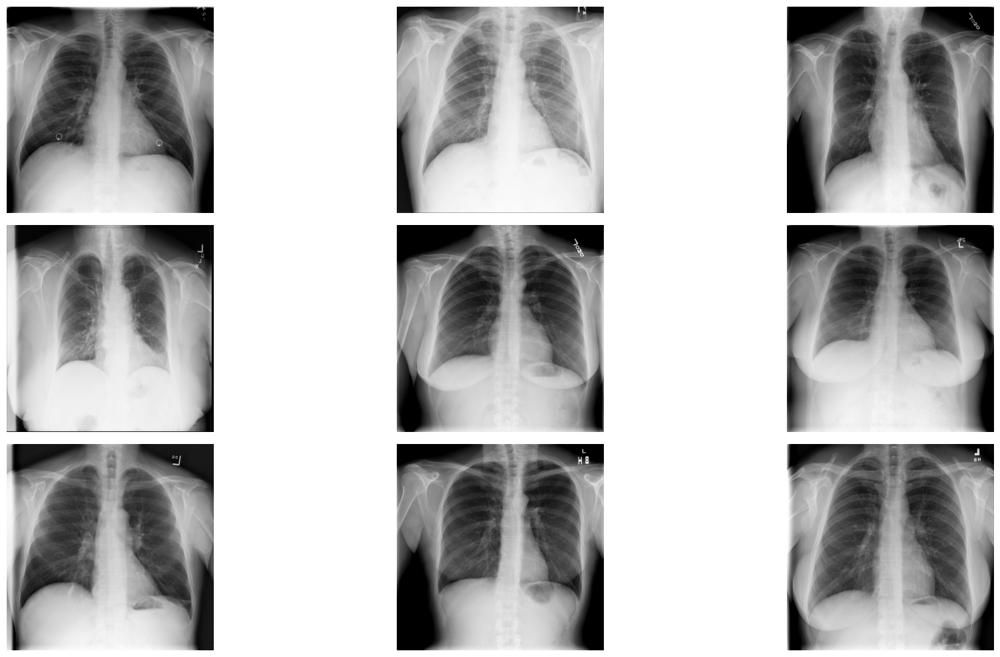

In [16]:
# Extract numpy values from Image column in data frame
images = train_df['Image'].values

# Extract 9 random images from it
random_images = [np.random.choice(images) for i in range(9)]

# Location of the image dir
img_dir = 'nih/images_small/'

print('Display Random Images')

# Adjust the size of your images
plt.figure(figsize=(20,10))

# Iterate and plot random images
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

# Adjust subplot parameters to give specified padding
plt.tight_layout()

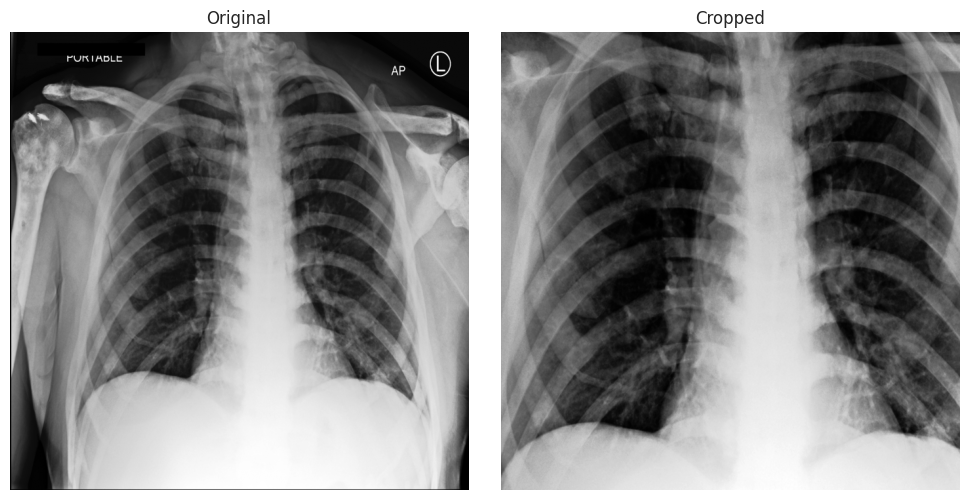

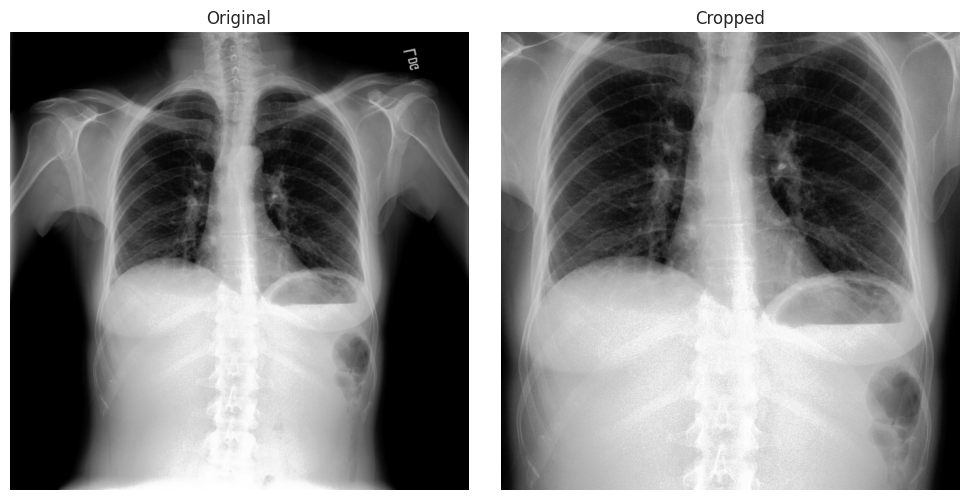

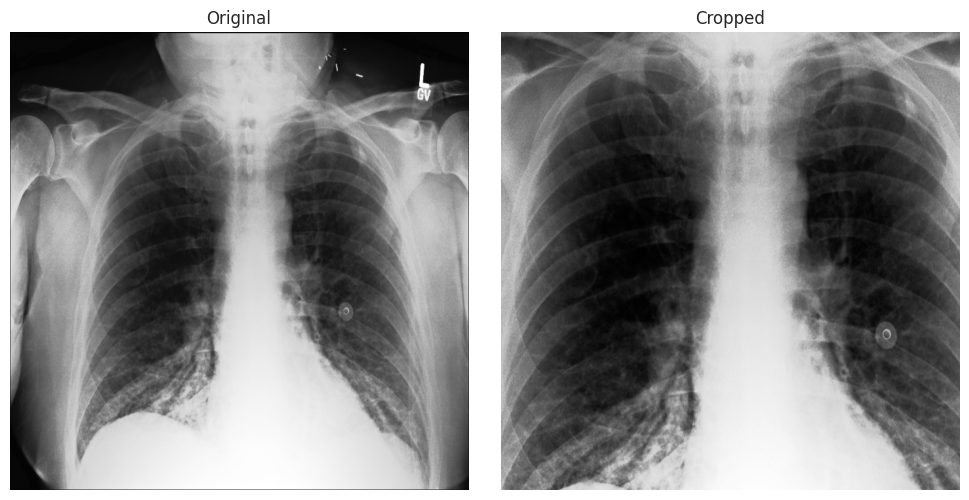

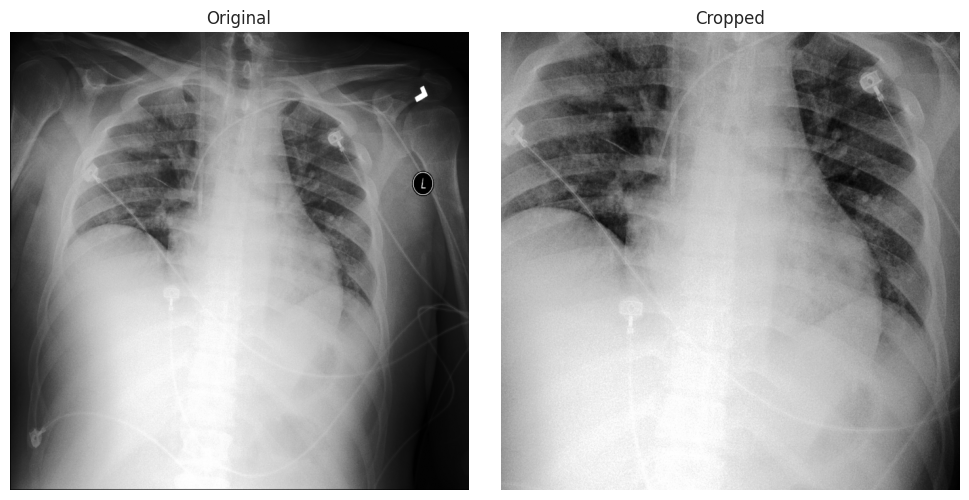

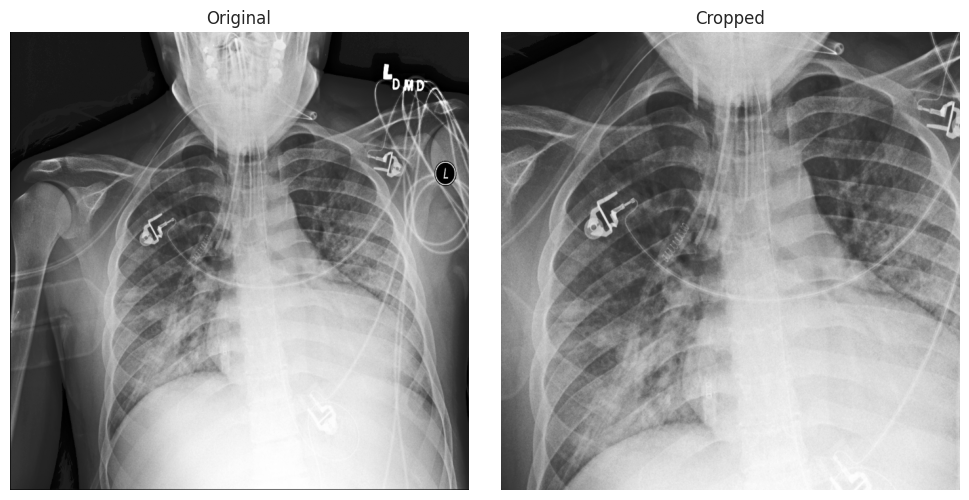

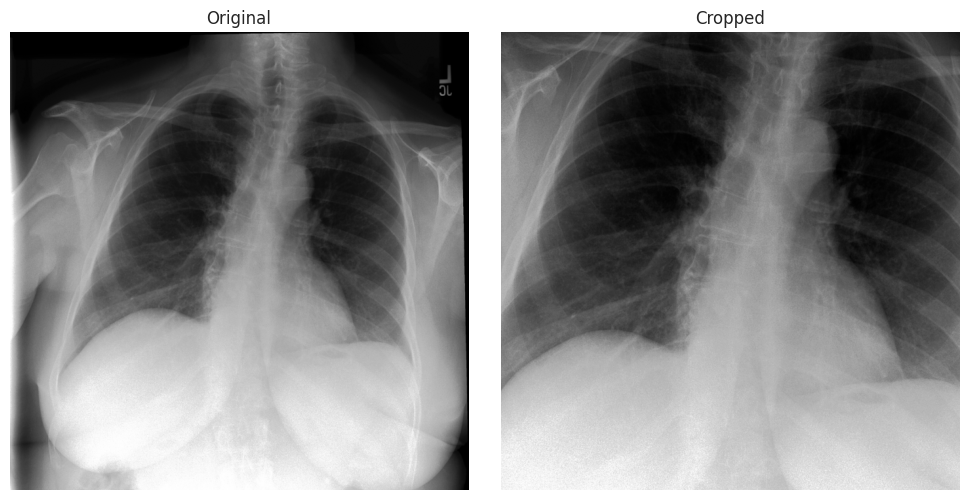

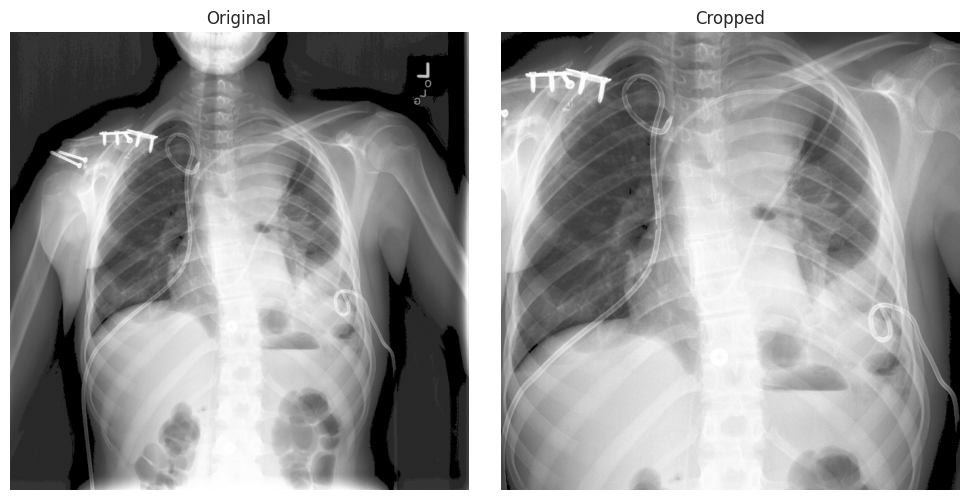

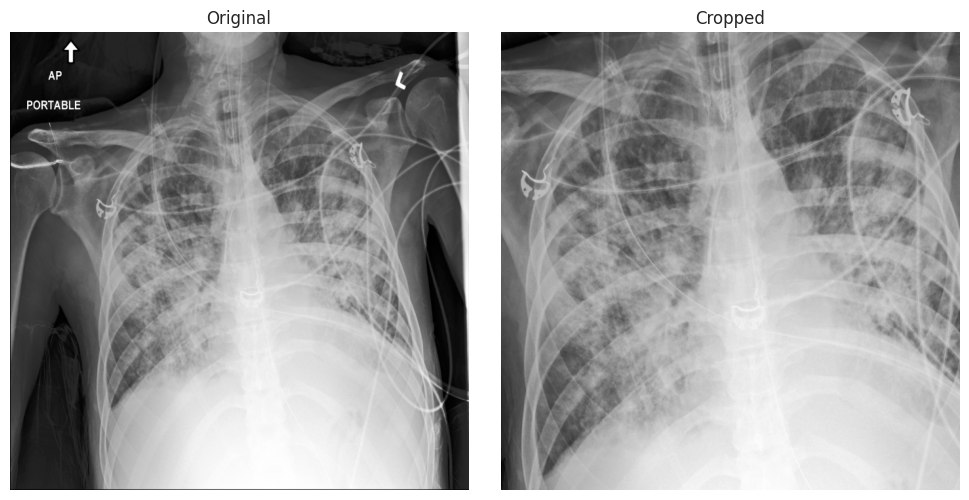

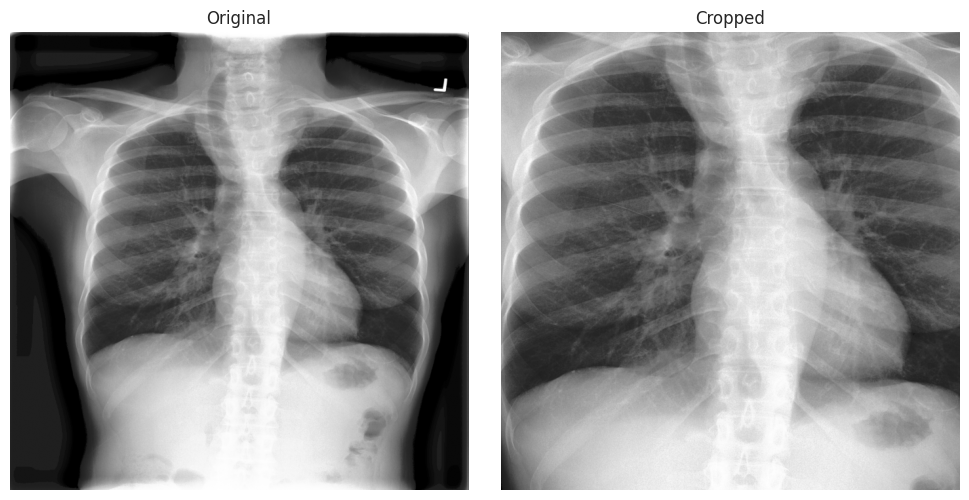

In [18]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

#cropped_images=[]

# Görüntüyü kırpma fonksiyonu (orta kısmı)
def crop_lung_region(image_path, output_size=(700, 700)):
    # Görseli gri tonlamaya çevirerek oku
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Histogram eşitleme (kontrast artırmak için)
    img_eq = cv2.equalizeHist(img)

    # Görüntü boyutlarını al
    h, w = img_eq.shape

    # Kırpmak için başlangıç ve bitiş koordinatlarını hesapla
    crop_w = output_size[0]
    crop_h = output_size[1]

    # Ortadaki bölgenin başlangıç noktası
    start_x = (w - crop_w) // 2
    start_y = (h - crop_h) // 2

    # Kırpma işlemi
    cropped_img = img_eq[start_y:start_y+crop_h, start_x:start_x+crop_w]

    # Kırpılan görüntüyü yeniden boyutlandır
    resized_cropped_img = cv2.resize(cropped_img, output_size)

    # Orijinal görüntüyü yeniden boyutlandır
    resized_img = cv2.resize(img_eq, output_size)

    #cropped_images.append(resized_cropped_img)

    return resized_img, resized_cropped_img

# Görselleri yan yana göstermek için fonksiyon
def plot_images(original_img, cropped_img, title1="Original", title2="Cropped"):
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(original_img, cmap='gray')
    ax[0].set_title(title1)
    ax[0].axis('off')

    ax[1].imshow(cropped_img, cmap='gray')
    ax[1].set_title(title2)
    ax[1].axis('off')

    plt.tight_layout()
    plt.show()

# Görüntülerin bulunduğu klasör
img_dir = 'nih/images_small/'  # Kendi klasör yolunuzu girin

# PNG formatındaki görselleri yükleme
image_files = [f for f in os.listdir(img_dir) if f.endswith('.png')]

# Eğer yeterince görsel yoksa hata mesajı ver
if len(image_files) < 9:
    print(f"Yeterli görsel bulunamadı. Bulunan görsel sayısı: {len(image_files)}")
else:
    # Rastgele 9 görsel seç
    random_images = np.random.choice(image_files, 9, replace=False)

    # Her bir rastgele görseli işleyip sonuçları göster
    for img_name in random_images:
        img_path = os.path.join(img_dir, img_name)
        original_img, cropped_img = crop_lung_region(img_path)
        plot_images(original_img, cropped_img)

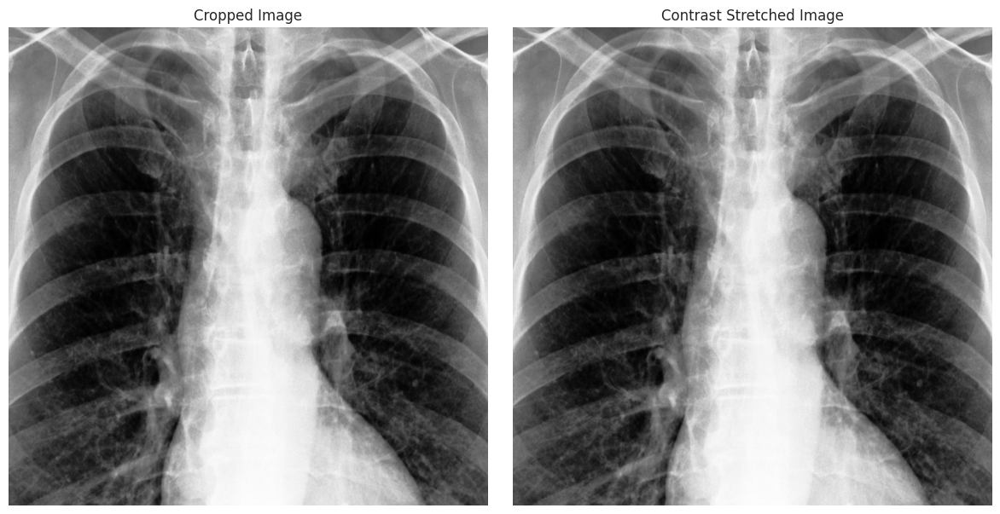

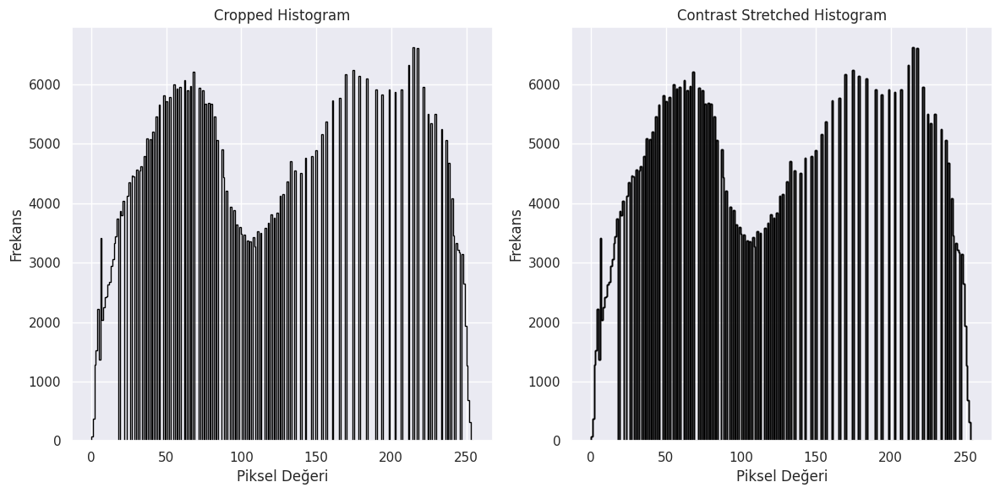

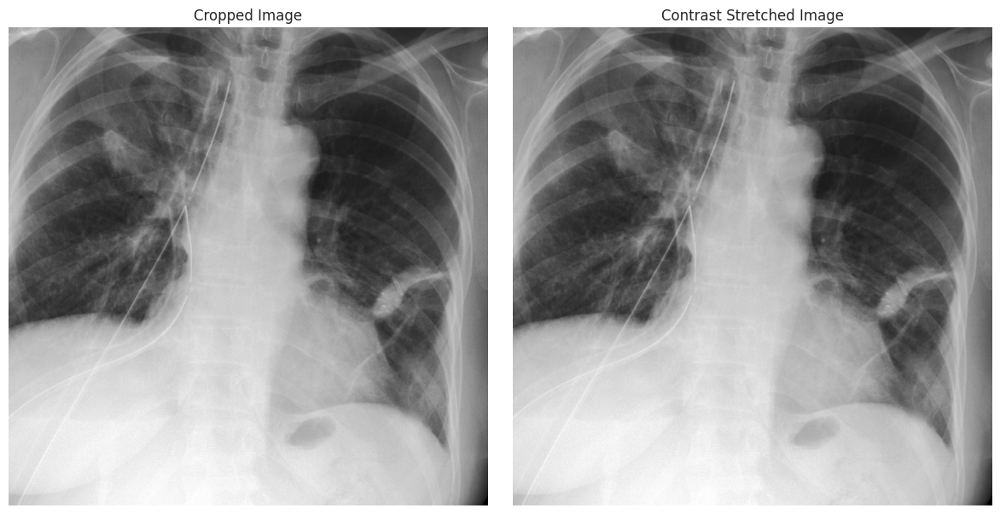

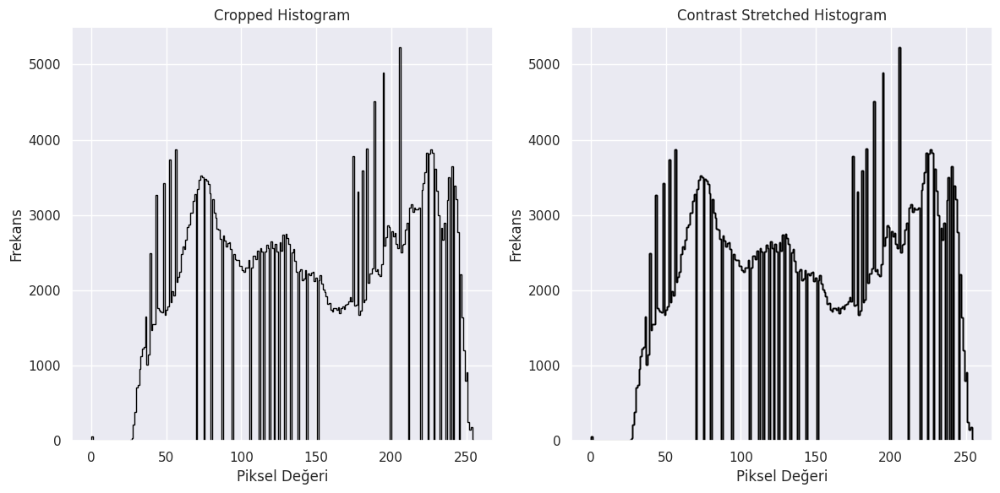

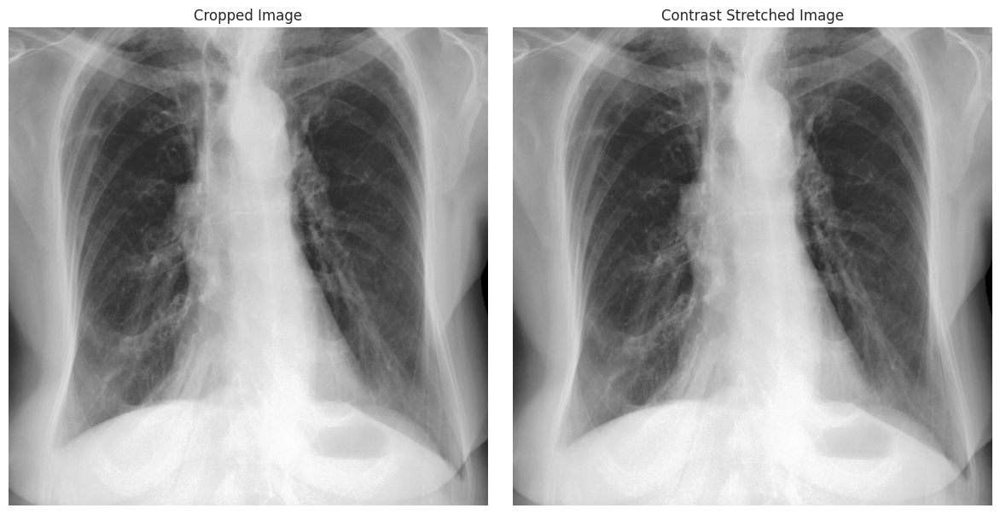

...

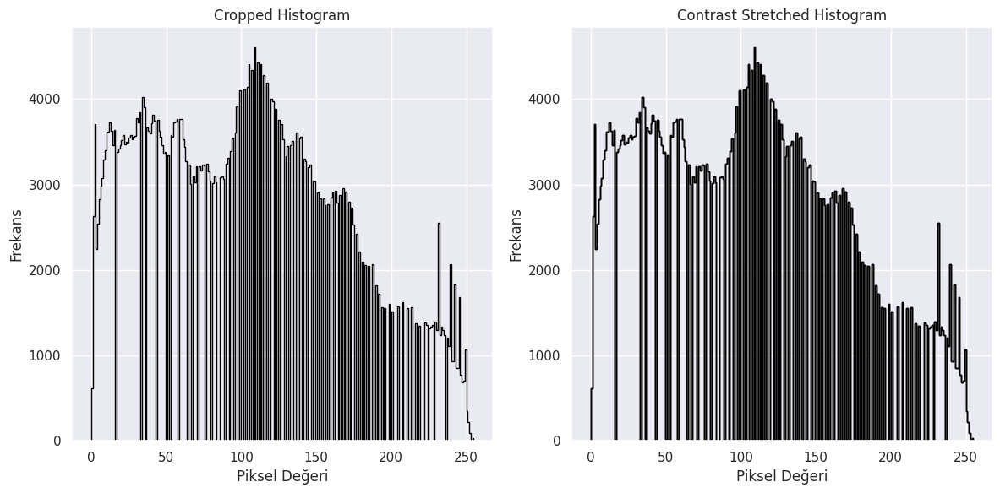

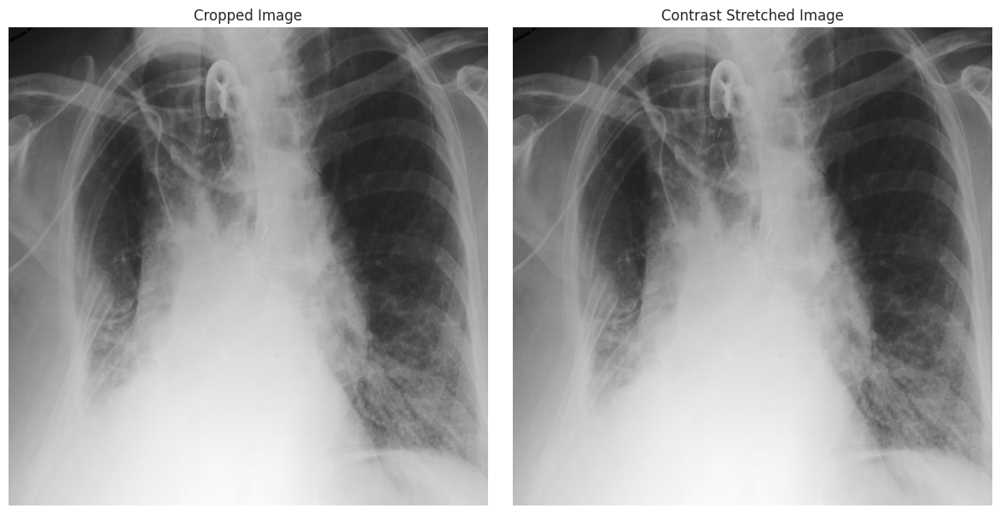

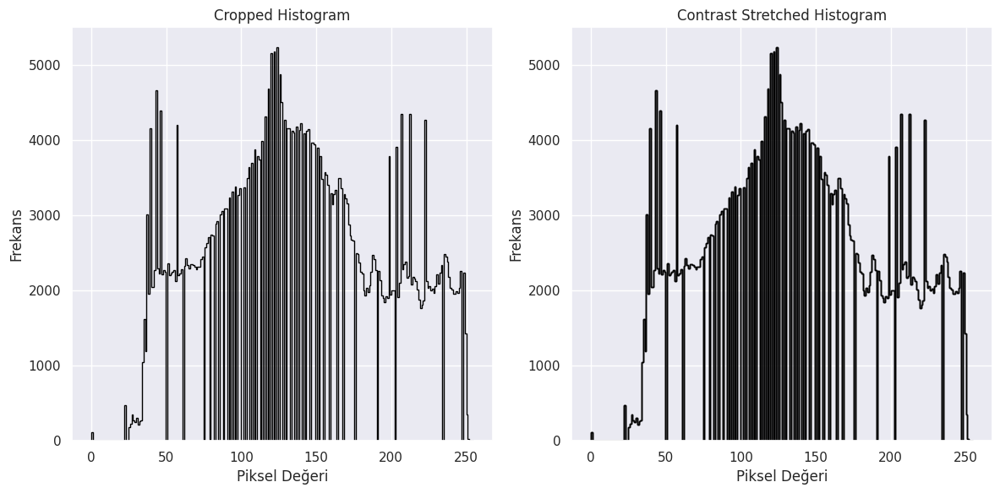

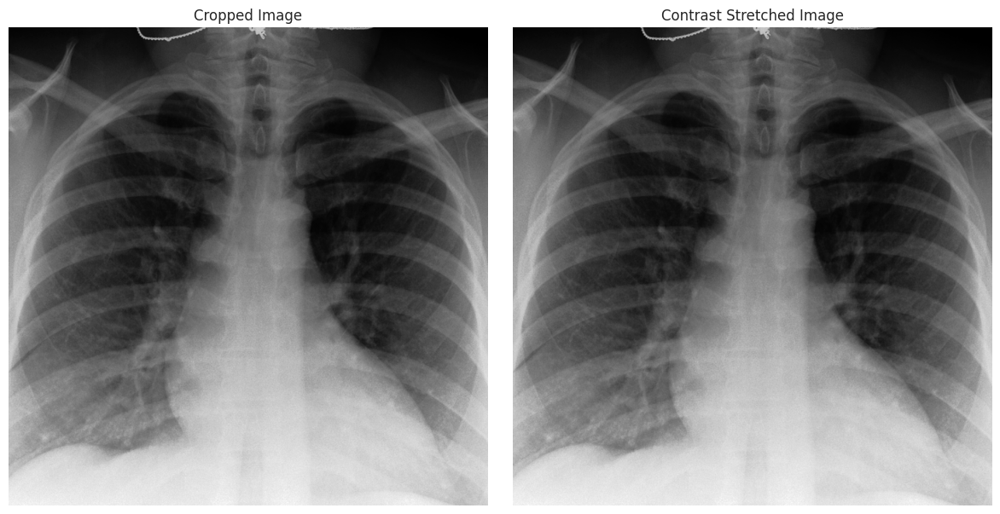

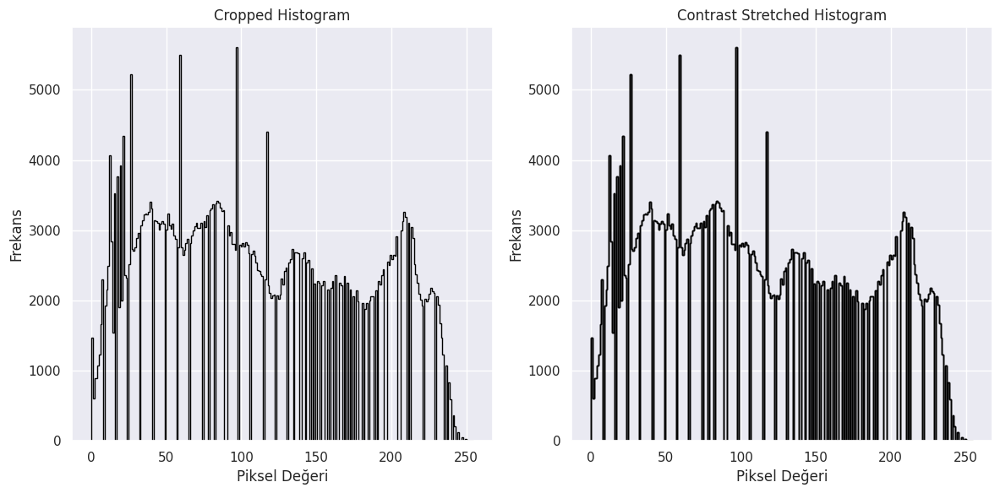

In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

cropped_images = []

# Contrast stretching fonksiyonu
def contrast_stretching(image):
    # Görüntüdeki min ve max piksel değerlerini bulun
    I_min = np.min(image)
    I_max = np.max(image)

    # S_min ve S_max genellikle 0 ve 255 olur
    S_min = 0
    S_max = 255

    # Contrast stretching formülü
    stretched_img = ((image - I_min) / (I_max - I_min)) * (S_max - S_min) + S_min
    stretched_img = np.uint8(stretched_img)  # Sonuçları 8-bit değerler olarak dönüştür

    return stretched_img

# Görüntüyü kırpma fonksiyonu (orta kısmı)
def crop_lung_region(image_path, output_size=(700, 700)):
    # Görseli gri tonlamaya çevirerek oku
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Histogram eşitleme (kontrast artırmak için)
    img_eq = cv2.equalizeHist(img)

    # Görüntü boyutlarını al
    h, w = img_eq.shape

    # Kırpmak için başlangıç ve bitiş koordinatlarını hesapla
    crop_w = output_size[0]
    crop_h = output_size[1]

    # Ortadaki bölgenin başlangıç noktası
    start_x = (w - crop_w) // 2
    start_y = (h - crop_h) // 2

    # Kırpma işlemi
    cropped_img = img_eq[start_y:start_y+crop_h, start_x:start_x+crop_w]

    # Kırpılan görüntüyü yeniden boyutlandır
    resized_cropped_img = cv2.resize(cropped_img, output_size)

    # Contrast stretching uygulama
    contrast_stretched_img = contrast_stretching(resized_cropped_img)

    # Orijinal görüntüyü yeniden boyutlandır
    resized_img = cv2.resize(img_eq, output_size)

    cropped_images.append(contrast_stretched_img)

    return resized_img, resized_cropped_img, contrast_stretched_img

# Histogram çizme fonksiyonu
def plot_histogram(image, title="Histogram"):
    plt.hist(image.ravel(), bins=256, histtype='step', color='black')
    plt.title(title)
    plt.xlabel('Piksel Değeri')
    plt.ylabel('Frekans')

# Görselleri ve histogramları yan yana göstermek için fonksiyon
def plot_images_and_histograms(original_img, cropped_img, contrast_stretched_img):
    # Görselleri yan yana göster
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    ax[0].imshow(cropped_img, cmap='gray')
    ax[0].set_title("Cropped Image")
    ax[0].axis('off')

    ax[1].imshow(contrast_stretched_img, cmap='gray')
    ax[1].set_title("Contrast Stretched Image")
    ax[1].axis('off')

    plt.tight_layout()
    plt.show()

    # Histogramları yan yana çiz
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    plot_histogram(cropped_img, title="Cropped Histogram")
    ax[0].hist(cropped_img.ravel(), bins=256, histtype='step', color='black')
    ax[0].set_title("Cropped Histogram")
    ax[0].set_xlabel('Piksel Değeri')
    ax[0].set_ylabel('Frekans')

    plot_histogram(contrast_stretched_img, title="Contrast Stretched Histogram")
    ax[1].hist(contrast_stretched_img.ravel(), bins=256, histtype='step', color='black')
    ax[1].set_title("Contrast Stretched Histogram")
    ax[1].set_xlabel('Piksel Değeri')
    ax[1].set_ylabel('Frekans')

    plt.tight_layout()
    plt.show()

# Görüntülerin bulunduğu klasör
img_dir = 'nih/images_small/'  # Kendi klasör yolunuzu girin

# PNG formatındaki görselleri yükleme
image_files = [f for f in os.listdir(img_dir) if f.endswith('.png')]

# Eğer yeterince görsel yoksa hata mesajı ver
if len(image_files) < 9:
    print(f"Yeterli görsel bulunamadı. Bulunan görsel sayısı: {len(image_files)}")
else:
    # Rastgele 9 görsel seç
    random_images = np.random.choice(image_files, 9, replace=False)

    # Her bir rastgele görseli işleyip sonuçları göster
    for img_name in random_images:
        img_path = os.path.join(img_dir, img_name)
        original_img, cropped_img, contrast_stretched_img = crop_lung_region(img_path)

        # Görselleri ve histogramları göster
        plot_images_and_histograms(cropped_img, contrast_stretched_img, contrast_stretched_img)

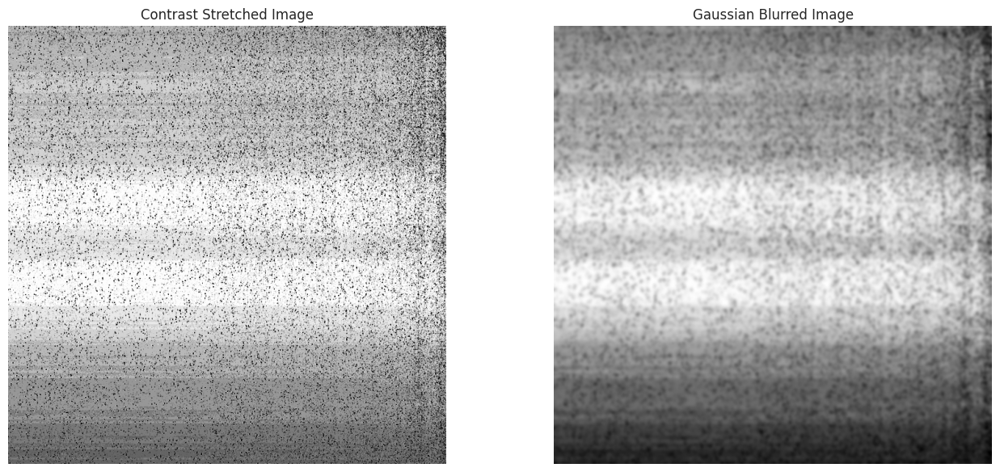

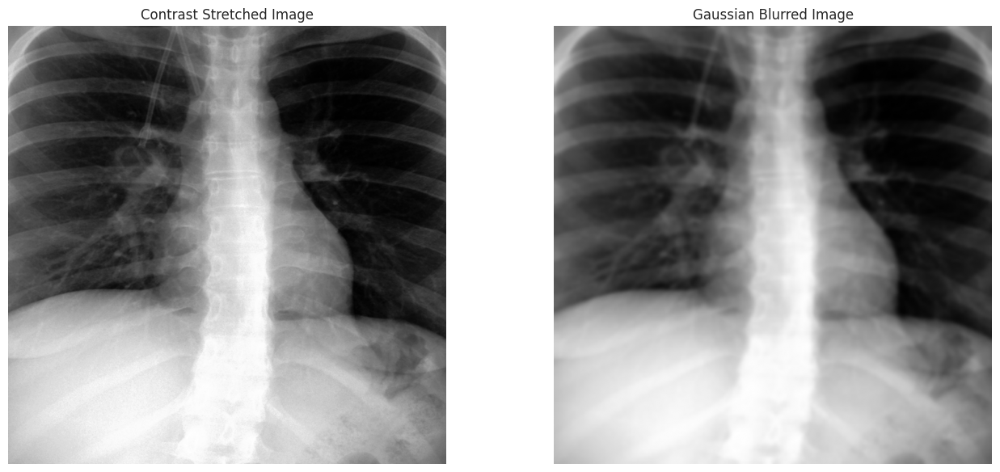

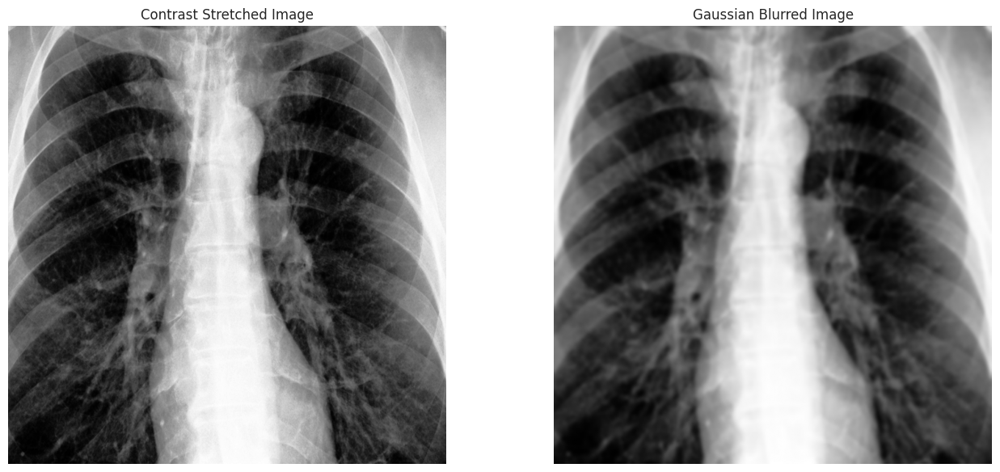

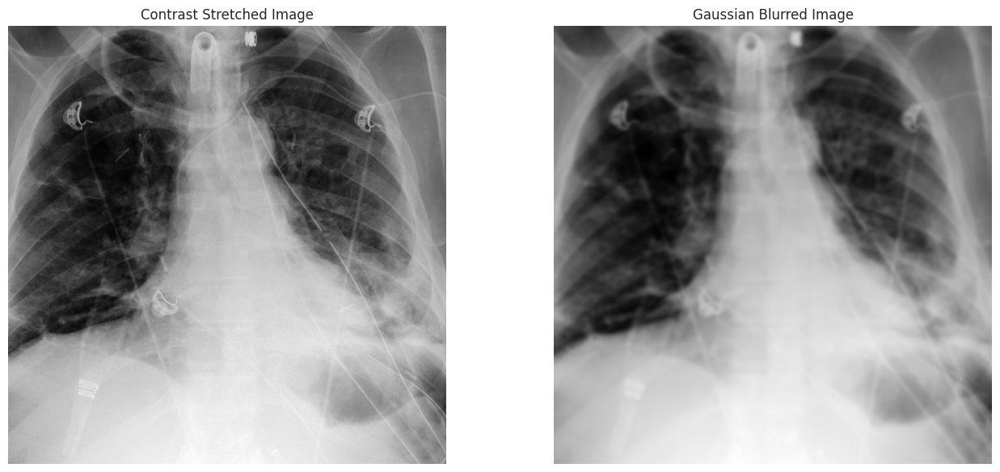

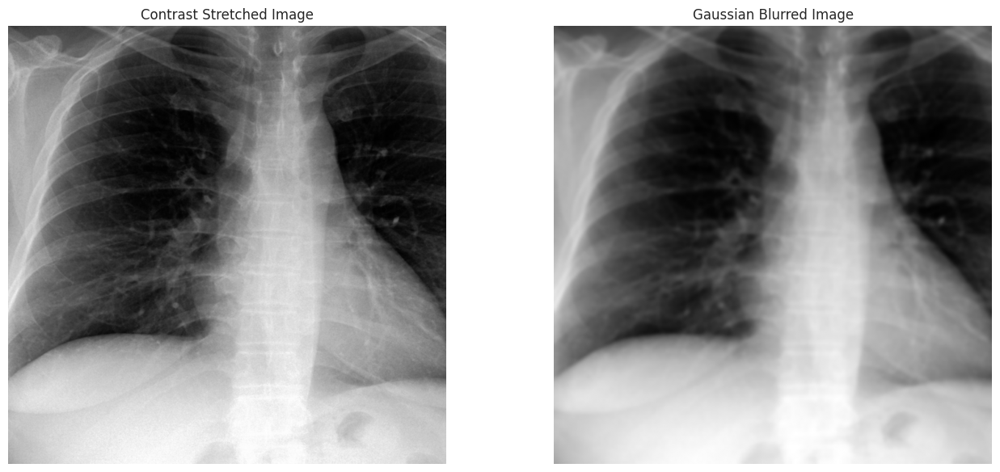

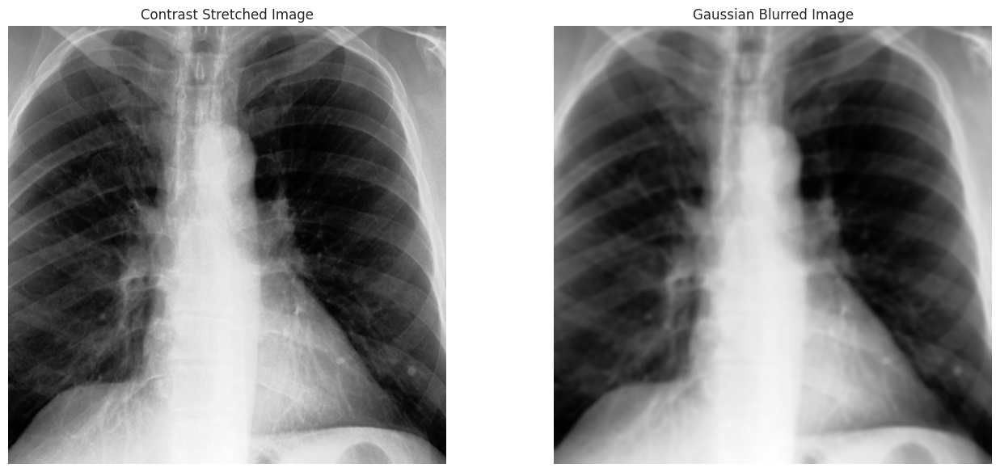

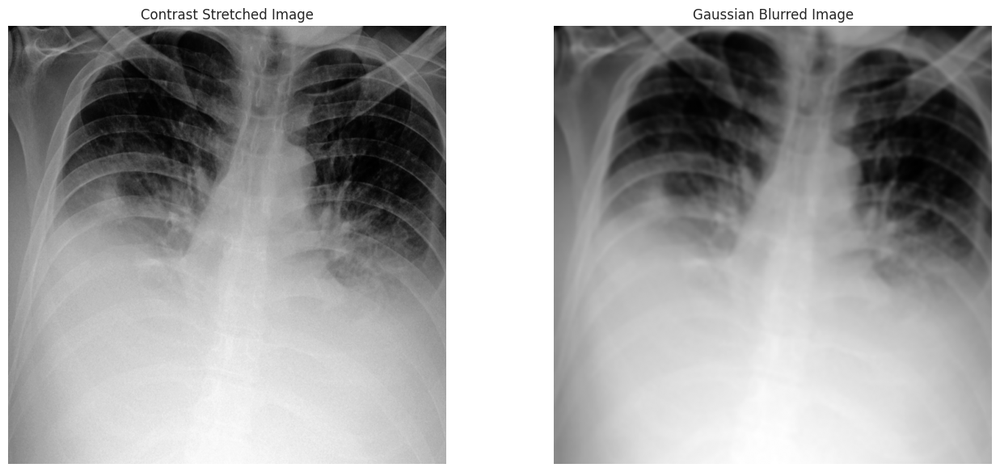

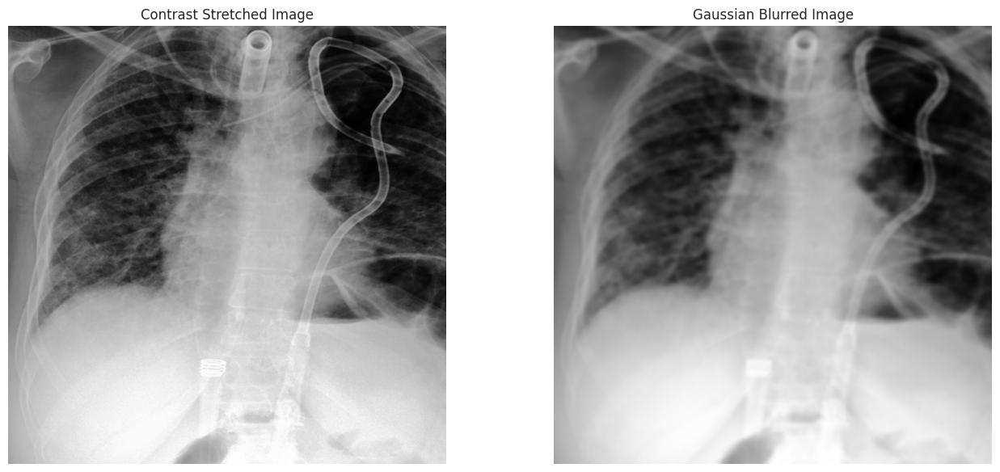

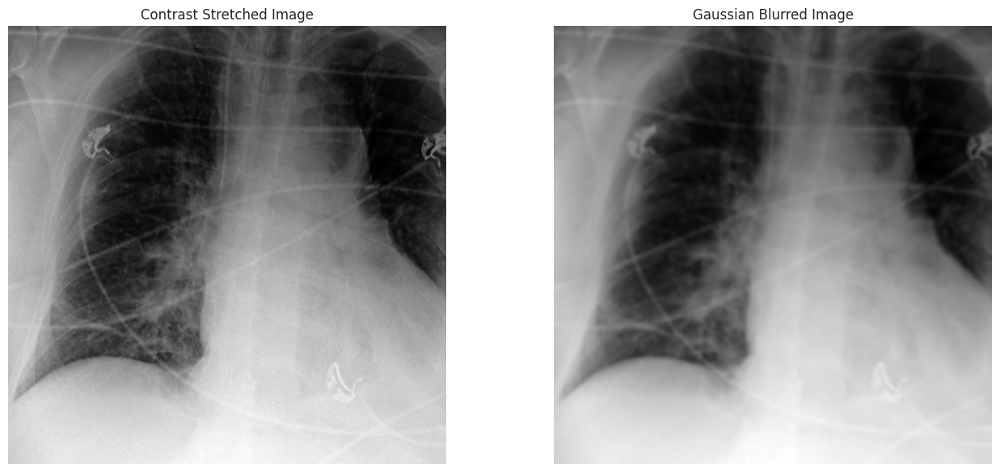

In [20]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

cropped_images = []

# Contrast stretching fonksiyonu
def contrast_stretching(image):
    # Görüntüdeki min ve max piksel değerlerini bulun
    I_min = np.min(image)
    I_max = np.max(image)

    # S_min ve S_max genellikle 0 ve 255 olur
    S_min = 0
    S_max = 255

    # Contrast stretching formülü
    stretched_img = ((image - I_min) / (I_max - I_min)) * (S_max - S_min) + S_min
    stretched_img = np.uint8(stretched_img)  # Sonuçları 8-bit değerler olarak dönüştür

    return stretched_img

# Görüntüyü kırpma fonksiyonu (orta kısmı)
def crop_lung_region(image_path, output_size=(700, 700)):
    # Görseli gri tonlamaya çevirerek oku
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Histogram eşitleme (kontrast artırmak için)
    img_eq = cv2.equalizeHist(img)

    # Görüntü boyutlarını al
    h, w = img_eq.shape

    # Kırpmak için başlangıç ve bitiş koordinatlarını hesapla
    crop_w = output_size[0]
    crop_h = output_size[1]

    # Ortadaki bölgenin başlangıç noktası
    start_x = (w - crop_w) // 2
    start_y = (h - crop_h) // 2

    # Kırpma işlemi
    cropped_img = img_eq[start_y:start_y+crop_h, start_x:start_x+crop_w]

    # Kırpılan görüntüyü yeniden boyutlandır
    resized_cropped_img = cv2.resize(cropped_img, output_size)

    # Contrast stretching uygulama
    contrast_stretched_img = contrast_stretching(resized_cropped_img)

    # Gaussian blur uygulama (kernel boyutunu büyüttük)
    blurred_img = cv2.GaussianBlur(contrast_stretched_img, (15, 15), 0)  # 15x15 kernel

    # Orijinal görüntüyü yeniden boyutlandır
    resized_img = cv2.resize(img_eq, output_size)

    cropped_images.append(blurred_img)

    return resized_img, contrast_stretched_img, blurred_img

# Görselleri yan yana göstermek için fonksiyon
def plot_images(contrast_stretched_img, blurred_img):
    # Görselleri yan yana göster
    fig, ax = plt.subplots(1, 2, figsize=(14, 6))

    ax[0].imshow(contrast_stretched_img, cmap='gray')
    ax[0].set_title("Contrast Stretched Image")
    ax[0].axis('off')

    ax[1].imshow(blurred_img, cmap='gray')
    ax[1].set_title("Gaussian Blurred Image")
    ax[1].axis('off')

    plt.tight_layout()
    plt.show()

# Görüntülerin bulunduğu klasör
img_dir = 'nih/images_small/'  # Kendi klasör yolunuzu girin

# PNG formatındaki görselleri yükleme
image_files = [f for f in os.listdir(img_dir) if f.endswith('.png')]

# Eğer yeterince görsel yoksa hata mesajı ver
if len(image_files) < 9:
    print(f"Yeterli görsel bulunamadı. Bulunan görsel sayısı: {len(image_files)}")
else:
    # Rastgele 9 görsel seç
    random_images = np.random.choice(image_files, 9, replace=False)

    # Her bir rastgele görseli işleyip sonuçları göster
    for img_name in random_images:
        img_path = os.path.join(img_dir, img_name)
        original_img, contrast_stretched_img, blurred_img = crop_lung_region(img_path)

        # Görselleri yan yana göster
        plot_images(contrast_stretched_img, blurred_img)

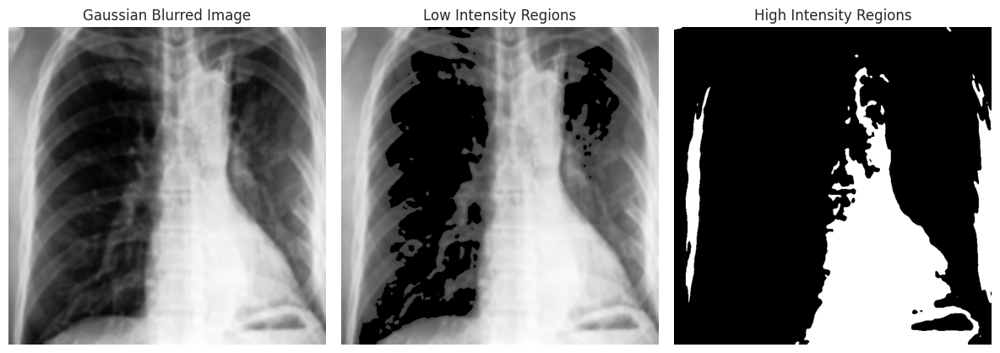

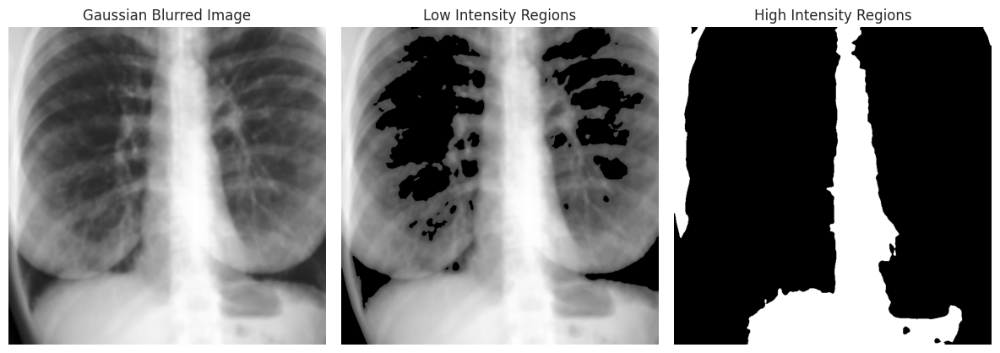

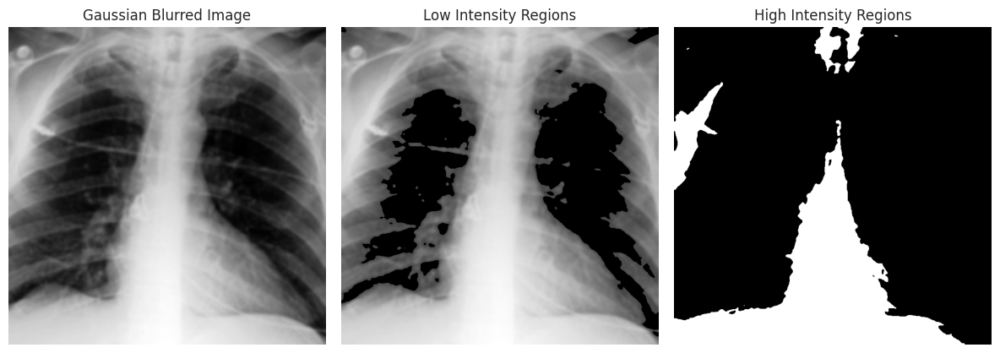

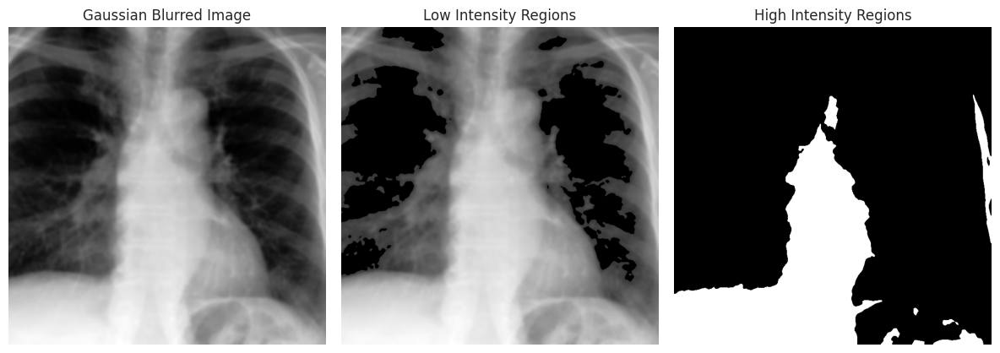

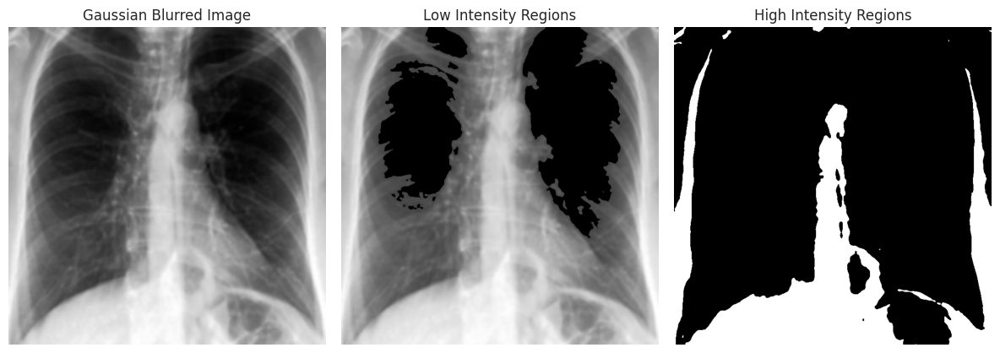

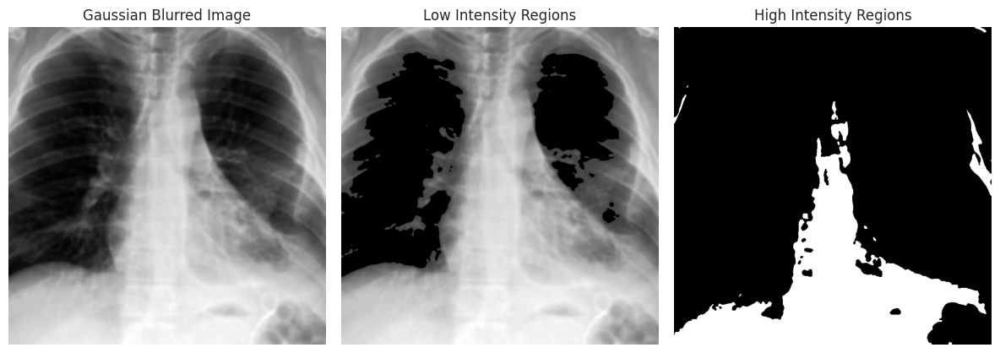

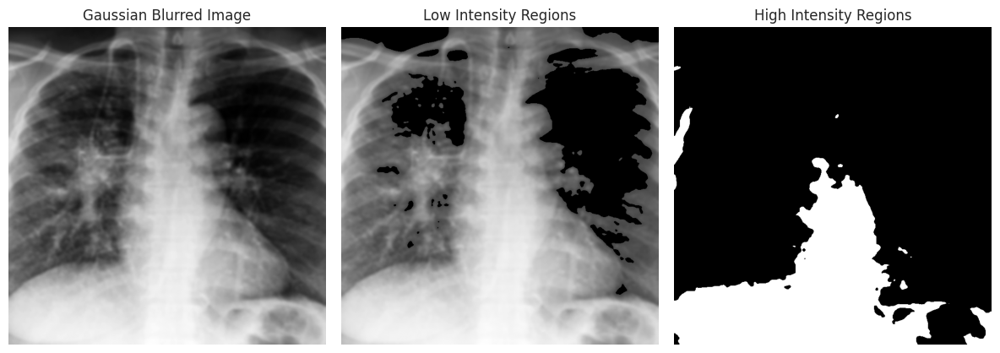

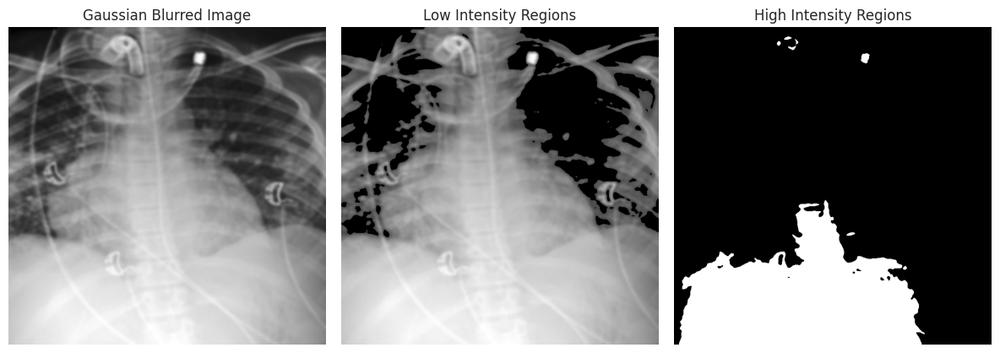

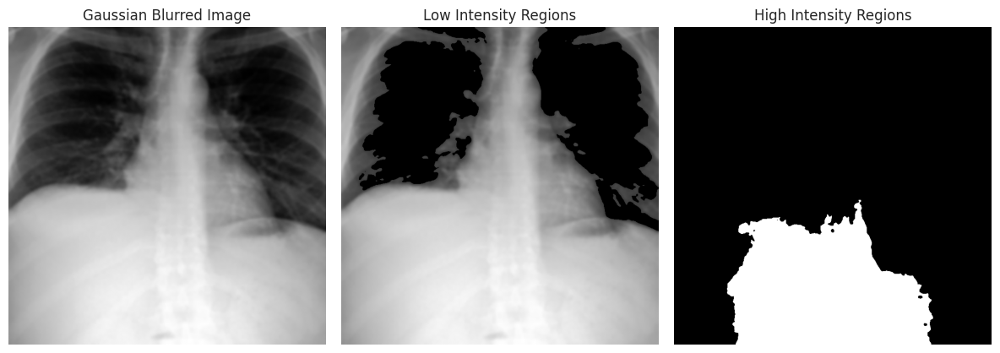

In [21]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

cropped_images = []

# Gaussian yoğunluk dönüşümü fonksiyonu
def gaussian_density_transform(blurred_img):
    # Görüntüdeki ortalama ve standart sapmayı hesapla
    mean, std_dev = cv2.meanStdDev(blurred_img)

    # Ortalama ve standart sapmayı tek bir değere çevir (gri tonlamada tek kanal)
    mean = mean[0][0]
    std_dev = std_dev[0][0]

    # Z-skoru ile eşikleme: Ortalama + 1*standart sapma ve Ortalama - 1*standart sapma
    lower_bound = mean - std_dev
    upper_bound = mean + std_dev

    # Düşük yoğunluk (lower_bound) ve yüksek yoğunluk (upper_bound) ayırma
    _, low_intensity_img = cv2.threshold(blurred_img, lower_bound, 255, cv2.THRESH_TOZERO)
    _, high_intensity_img = cv2.threshold(blurred_img, upper_bound, 255, cv2.THRESH_BINARY)

    return low_intensity_img, high_intensity_img

# Görüntüyü kırpma fonksiyonu (orta kısmı)
def crop_lung_region(image_path, output_size=(700, 700)):
    # Görseli gri tonlamaya çevirerek oku
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Histogram eşitleme (kontrast artırmak için)
    img_eq = cv2.equalizeHist(img)

    # Görüntü boyutlarını al
    h, w = img_eq.shape

    # Kırpmak için başlangıç ve bitiş koordinatlarını hesapla
    crop_w = output_size[0]
    crop_h = output_size[1]

    # Ortadaki bölgenin başlangıç noktası
    start_x = (w - crop_w) // 2
    start_y = (h - crop_h) // 2

    # Kırpma işlemi
    cropped_img = img_eq[start_y:start_y+crop_h, start_x:start_x+crop_w]

    # Kırpılan görüntüyü yeniden boyutlandır
    resized_cropped_img = cv2.resize(cropped_img, output_size)

    # Gaussian blur uygulama (kernel boyutunu büyüttük)
    blurred_img = cv2.GaussianBlur(resized_cropped_img, (15, 15), 0)  # 15x15 kernel

    # Gauss yoğunluk dönüşümü uygulama
    low_intensity_img, high_intensity_img = gaussian_density_transform(blurred_img)

    # Orijinal görüntüyü yeniden boyutlandır
    resized_img = cv2.resize(img_eq, output_size)

    cropped_images.append(blurred_img)

    return resized_img, blurred_img, low_intensity_img, high_intensity_img

# Görselleri yan yana göstermek için fonksiyon
def plot_images(blurred_img, low_intensity_img, high_intensity_img):
    # Görselleri yan yana göster
    fig, ax = plt.subplots(1, 3, figsize=(12, 5))

    # Görselleri göster
    ax[0].imshow(blurred_img, cmap='gray')
    ax[0].set_title("Gaussian Blurred Image")
    ax[0].axis('off')

    ax[1].imshow(low_intensity_img, cmap='gray')
    ax[1].set_title("Low Intensity Regions")
    ax[1].axis('off')

    ax[2].imshow(high_intensity_img, cmap='gray')
    ax[2].set_title("High Intensity Regions")
    ax[2].axis('off')

    plt.tight_layout()
    plt.show()

# Görüntülerin bulunduğu klasör
img_dir = 'nih/images_small/'  # Kendi klasör yolunuzu girin

# PNG formatındaki görselleri yükleme
image_files = [f for f in os.listdir(img_dir) if f.endswith('.png')]

# Eğer yeterince görsel yoksa hata mesajı ver
if len(image_files) < 9:
    print(f"Yeterli görsel bulunamadı. Bulunan görsel sayısı: {len(image_files)}")
else:
    # Rastgele 9 görsel seç
    random_images = np.random.choice(image_files, 9, replace=False)

    # Her bir rastgele görseli işleyip sonuçları göster
    for img_name in random_images:
        img_path = os.path.join(img_dir, img_name)
        original_img, blurred_img, low_intensity_img, high_intensity_img = crop_lung_region(img_path)

        # Görselleri yan yana göster
        plot_images(blurred_img, low_intensity_img, high_intensity_img)

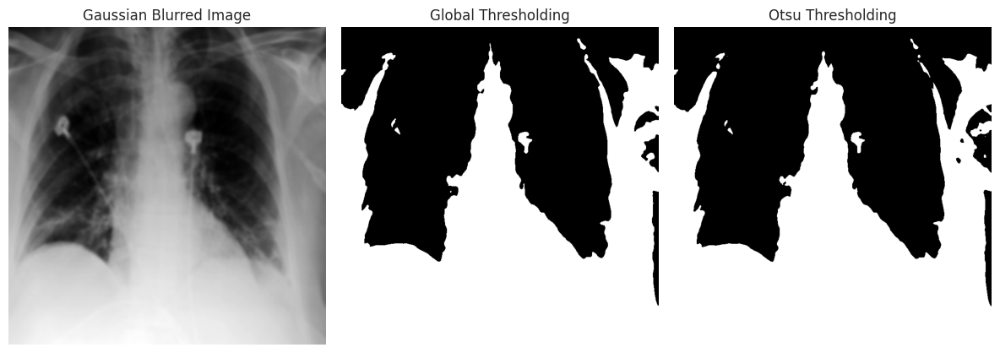

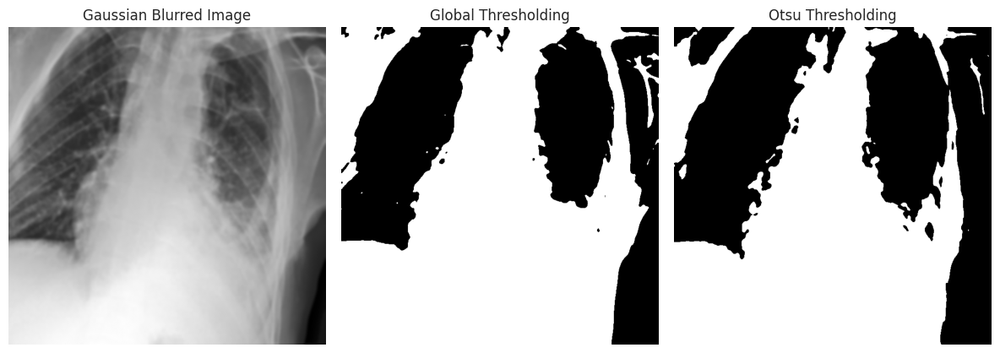

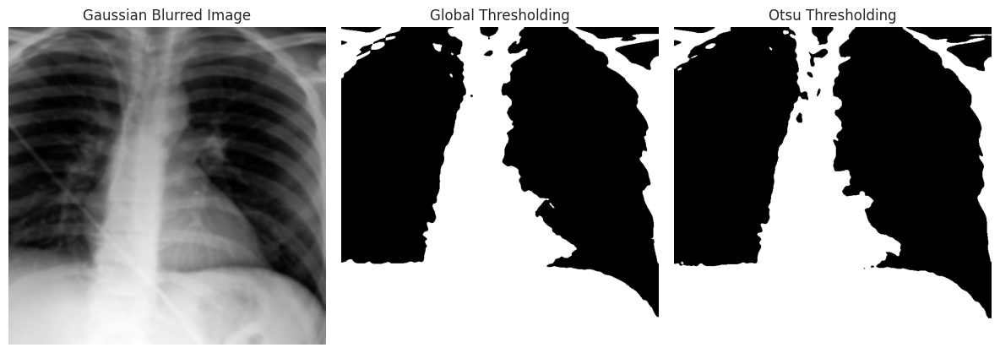

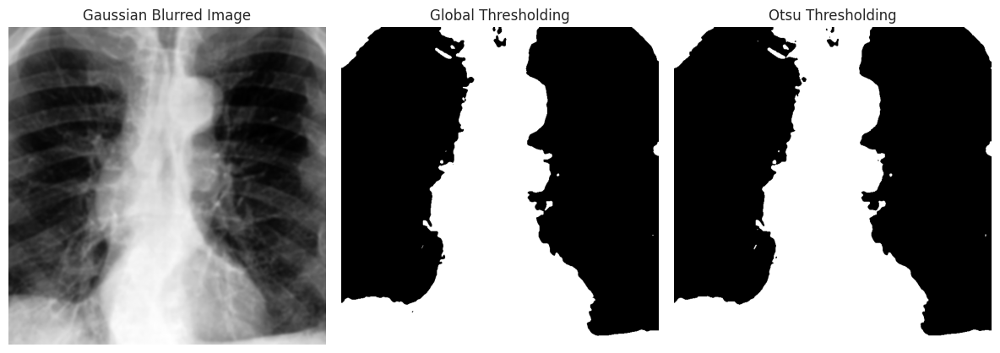

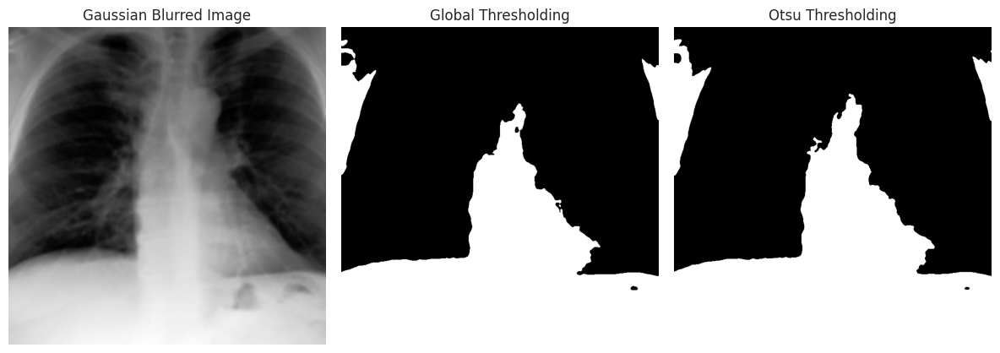

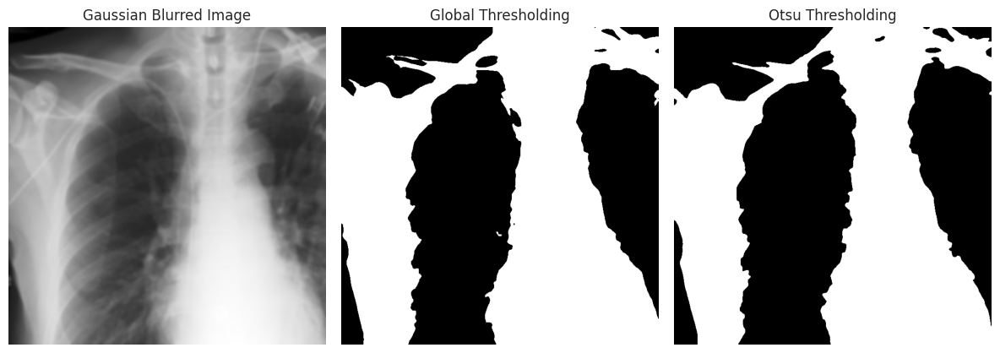

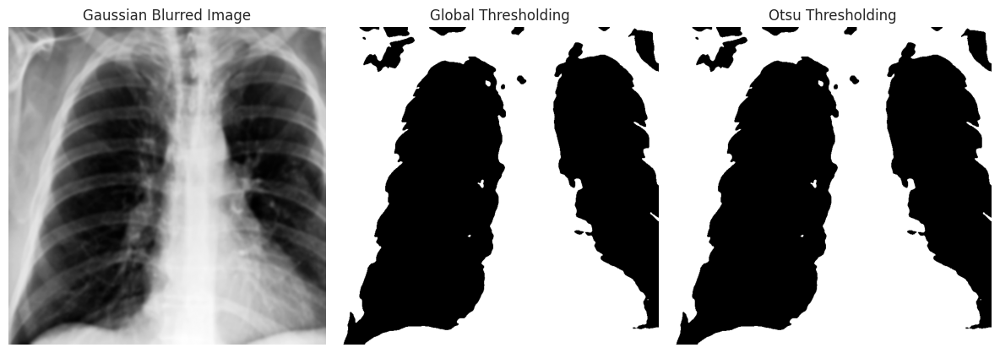

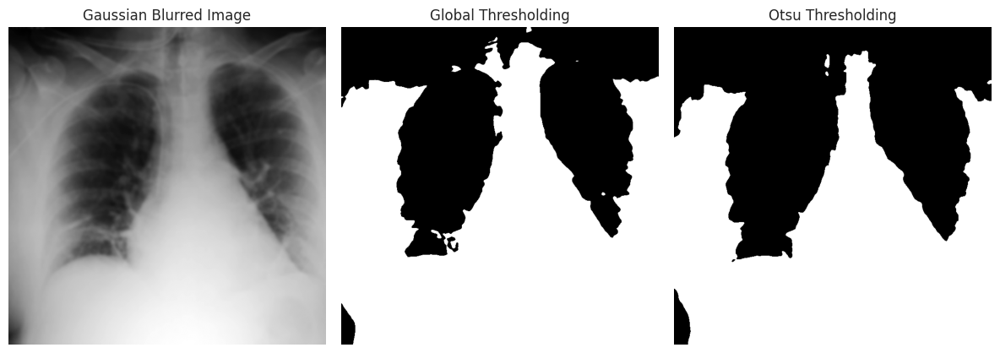

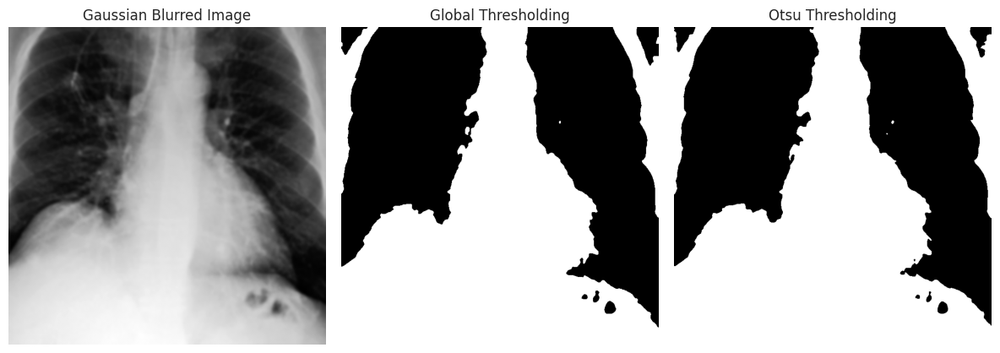

In [22]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

cropped_images = []

# Otsu Thresholding fonksiyonu
def otsu_thresholding(img):
    # Otsu Thresholding
    _, otsu_thresh_img = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    return otsu_thresh_img

# Global Thresholding fonksiyonu
def global_thresholding(img, threshold_value=127):
    # Global Thresholding (sabit eşik değeri ile)
    _, global_thresh_img = cv2.threshold(img, threshold_value, 255, cv2.THRESH_BINARY)
    return global_thresh_img

# Görüntüyü kırpma fonksiyonu (orta kısmı)
def crop_lung_region(image_path, output_size=(700, 700)):
    # Görseli gri tonlamaya çevirerek oku
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Histogram eşitleme (kontrast artırmak için)
    img_eq = cv2.equalizeHist(img)

    # Görüntü boyutlarını al
    h, w = img_eq.shape

    # Orta kısmı kırpmak için başlangıç ve bitiş koordinatlarını hesapla
    crop_w = output_size[0]
    crop_h = output_size[1]

    # Ortadaki bölgenin başlangıç noktası
    start_x = (w - crop_w) // 2
    start_y = (h - crop_h) // 2

    # Kırpma işlemi
    cropped_img = img_eq[start_y:start_y+crop_h, start_x:start_x+crop_w]

    # Kırpılan görüntüyü yeniden boyutlandır
    resized_cropped_img = cv2.resize(cropped_img, output_size)

    # Gaussian blur uygulama (kernel boyutunu büyüttük)
    blurred_img = cv2.GaussianBlur(resized_cropped_img, (15, 15), 0)  # 15x15 kernel

    # Global Thresholding
    global_thresh_img = global_thresholding(blurred_img)

    # Otsu Thresholding
    otsu_thresh_img = otsu_thresholding(blurred_img)

    # Orijinal görüntüyü yeniden boyutlandır
    resized_img = cv2.resize(img_eq, output_size)

    cropped_images.append(blurred_img)

    return resized_img, blurred_img, global_thresh_img, otsu_thresh_img

# Görselleri yan yana göstermek için fonksiyon
def plot_images(blurred_img, global_thresh_img, otsu_thresh_img):
    # Görselleri yan yana göster
    fig, ax = plt.subplots(1, 3, figsize=(12, 5))

    # Görselleri göster
    ax[0].imshow(blurred_img, cmap='gray')
    ax[0].set_title("Gaussian Blurred Image")
    ax[0].axis('off')

    ax[1].imshow(global_thresh_img, cmap='gray')
    ax[1].set_title("Global Thresholding")
    ax[1].axis('off')

    ax[2].imshow(otsu_thresh_img, cmap='gray')
    ax[2].set_title("Otsu Thresholding")
    ax[2].axis('off')

    plt.tight_layout()
    plt.show()

# Görüntülerin bulunduğu klasör
img_dir = 'nih/images_small/'  # Kendi klasör yolunuzu girin

# PNG formatındaki görselleri yükleme
image_files = [f for f in os.listdir(img_dir) if f.endswith('.png')]

# Eğer yeterince görsel yoksa hata mesajı ver
if len(image_files) < 9:
    print(f"Yeterli görsel bulunamadı. Bulunan görsel sayısı: {len(image_files)}")
else:
    # Rastgele 9 görsel seç
    random_images = np.random.choice(image_files, 9, replace=False)

    # Her bir rastgele görseli işleyip sonuçları göster
    for img_name in random_images:
        img_path = os.path.join(img_dir, img_name)
        original_img, blurred_img, global_thresh_img, otsu_thresh_img = crop_lung_region(img_path)

        # Görselleri yan yana göster
        plot_images(blurred_img, global_thresh_img, otsu_thresh_img)

Number of connected components: 6


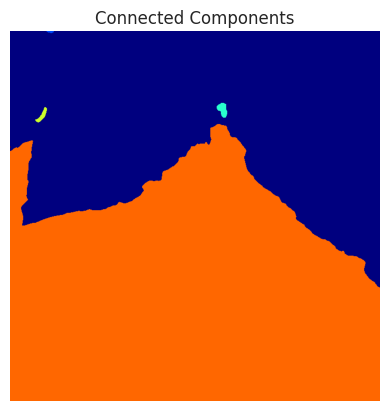

Label: 1
Centroid: (1.0975609756097562, 76.09756097560975)
Area: 41.0
Bounding Box: (0, 69, 4, 83)
Perimeter: 27.656854249492376
Eccentricity: 0.9617969447981478
------------------------------
Label: 2
Centroid: (148.28726287262873, 401.8319783197832)
Area: 369.0
Bounding Box: (136, 391, 164, 411)
Perimeter: 79.11269837220809
Eccentricity: 0.8177631448518585
------------------------------
Label: 3
Centroid: (159.45106382978724, 60.353191489361706)
Area: 235.0
Bounding Box: (144, 48, 173, 70)
Perimeter: 78.66904755831213
Eccentricity: 0.9623857252943452
------------------------------
Label: 4
Centroid: (499.7054632181944, 335.3897734618214)
Area: 269182.0
Bounding Box: (176, 0, 700, 700)
Perimeter: 2625.9108216936543
Eccentricity: 0.7650681474048114
------------------------------
Label: 5
Centroid: (219.0, 0.0)
Area: 3.0
Bounding Box: (218, 0, 221, 1)
Perimeter: 1.0
Eccentricity: 1.0
------------------------------
Selected Region: 4, Area: 269182.0
Selected Region: 2, Area: 369.0


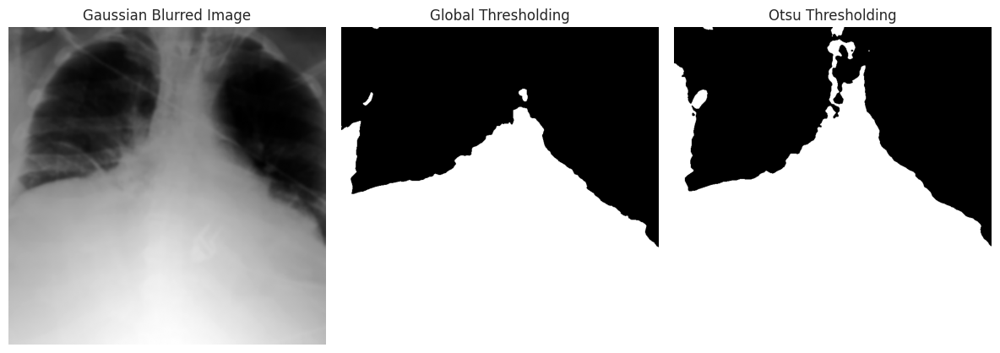

Number of connected components: 11


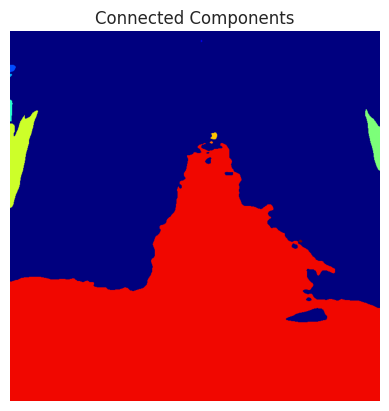

Label: 1
Centroid: (18.5, 361.8)
Area: 10.0
Bounding Box: (17, 361, 21, 364)
Perimeter: 8.82842712474619
Eccentricity: 0.6831300510639732
------------------------------
Label: 2
Centroid: (69.77310924369748, 4.109243697478991)
Area: 119.0
Bounding Box: (64, 0, 78, 11)
Perimeter: 40.72792206135786
Eccentricity: 0.6494765147571958
------------------------------
Label: 3
Centroid: (83.0, 1.1176470588235294)
Area: 17.0
Bounding Box: (81, 0, 87, 4)
Perimeter: 13.65685424949238
Eccentricity: 0.7739803621243568
------------------------------
Label: 4
Centroid: (149.05228758169935, 1.4183006535947713)
Area: 153.0
Bounding Box: (130, 0, 171, 5)
Perimeter: 85.07106781186548
Eccentricity: 0.995165867091906
------------------------------
Label: 5
Centroid: (202.3068181818182, 688.8882575757576)
Area: 1584.0
Bounding Box: (148, 672, 264, 700)
Perimeter: 253.5035713374682
Eccentricity: 0.98182522888263
------------------------------
Label: 6
Centroid: (228.84848484848484, 17.092056932966024)
Area: 4

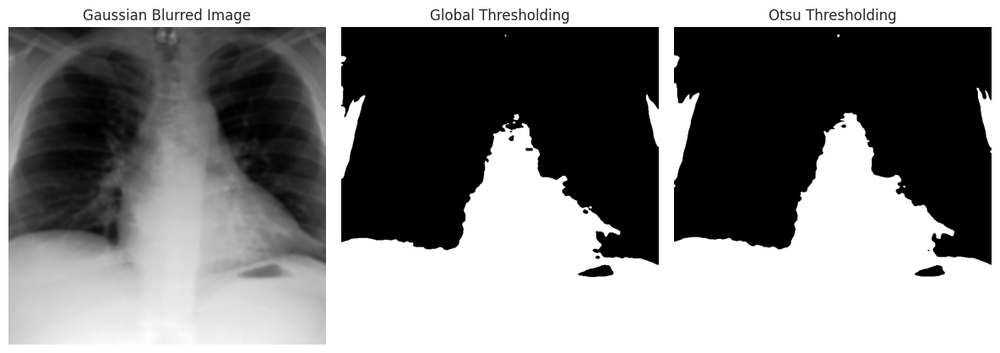

Number of connected components: 5


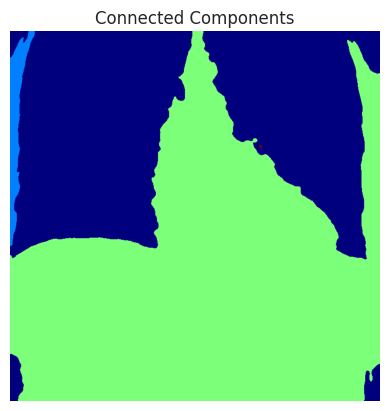

Label: 1
Centroid: (170.53403447268477, 11.21384750219106)
Area: 6846.0
Bounding Box: (0, 0, 407, 47)
Perimeter: 898.6345596729059
Eccentricity: 0.9976610859298535
------------------------------
Label: 2
Centroid: (468.26318554686134, 375.32515008651427)
Area: 285502.0
Bounding Box: (0, 0, 700, 700)
Perimeter: 3700.5941546018394
Eccentricity: 0.6302176986688264
------------------------------
Label: 3
Centroid: (146.0, 294.0)
Area: 1.0
Bounding Box: (146, 294, 147, 295)
Perimeter: 0.0
Eccentricity: 0
------------------------------
Label: 4
Centroid: (217.76, 473.64)
Area: 25.0
Bounding Box: (215, 471, 221, 477)
Perimeter: 15.899494936611665
Eccentricity: 0.5417573775069717
------------------------------
Selected Region: 2, Area: 285502.0
Selected Region: 1, Area: 6846.0


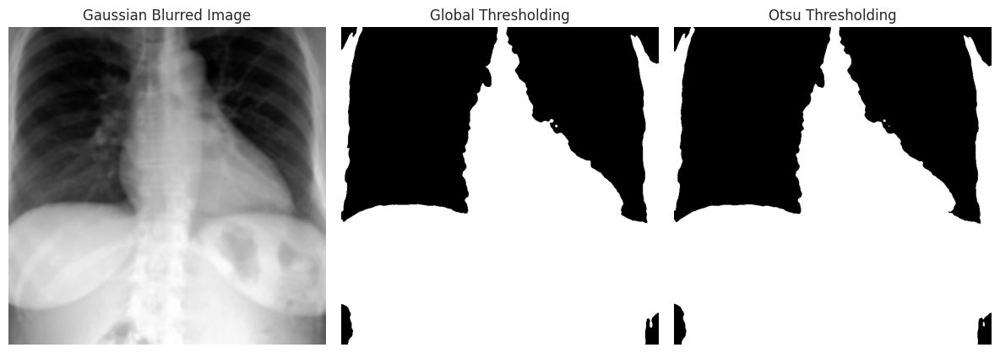

Number of connected components: 7


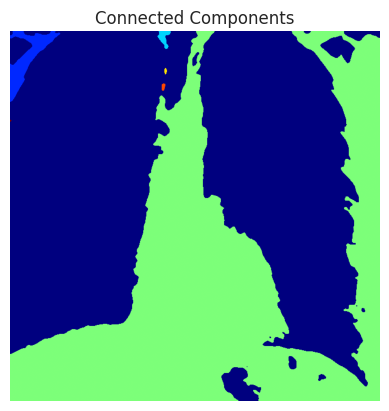

Label: 1
Centroid: (50.732469512195124, 32.18267276422764)
Area: 3936.0
Bounding Box: (0, 0, 134, 95)
Perimeter: 483.002092041053
Eccentricity: 0.9294034450158466
------------------------------
Label: 2
Centroid: (12.280742459396752, 290.74477958236656)
Area: 431.0
Bounding Box: (0, 279, 34, 304)
Perimeter: 109.0477272147525
Eccentricity: 0.8163963588422809
------------------------------
Label: 3
Centroid: (464.7132858533586, 399.7438796946252)
Area: 195170.0
Bounding Box: (0, 0, 700, 700)
Perimeter: 5440.0817074858805
Eccentricity: 0.7417816423938696
------------------------------
Label: 4
Centroid: (75.3695652173913, 293.8695652173913)
Area: 46.0
Bounding Box: (70, 292, 82, 297)
Perimeter: 26.485281374238568
Eccentricity: 0.91140539560713
------------------------------
Label: 5
Centroid: (105.25641025641026, 289.6666666666667)
Area: 78.0
Bounding Box: (99, 287, 113, 294)
Perimeter: 33.89949493661166
Eccentricity: 0.8857227924053115
------------------------------
Label: 6
Centroid: (1

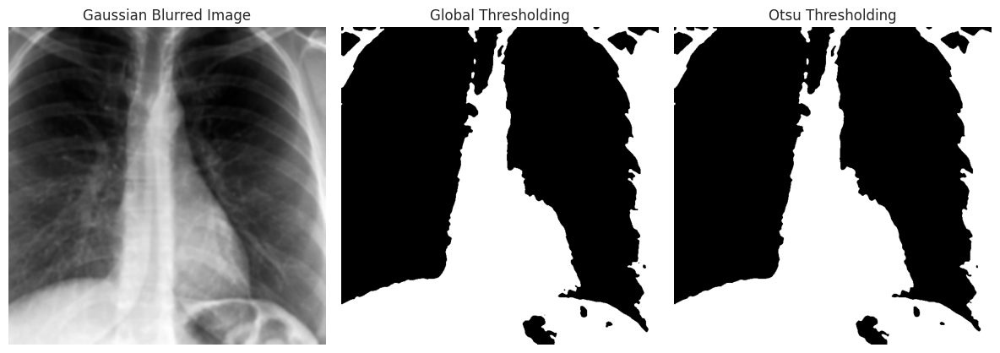

Number of connected components: 6


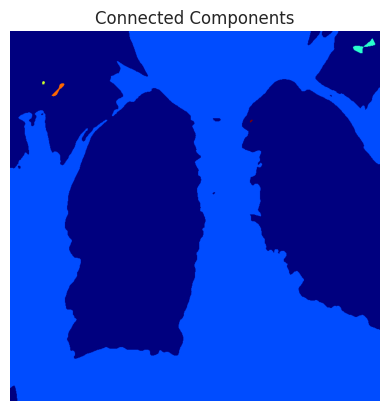

Label: 1
Centroid: (408.6627534425138, 346.52377781116627)
Area: 246259.0
Bounding Box: (0, 0, 700, 700)
Perimeter: 5830.995487772365
Eccentricity: 0.49359427521791377
------------------------------
Label: 2
Centroid: (28.916201117318437, 669.1648044692737)
Area: 358.0
Bounding Box: (14, 649, 42, 691)
Perimeter: 113.9116882454314
Eccentricity: 0.9612566774861537
------------------------------
Label: 3
Centroid: (97.53846153846153, 62.84615384615385)
Area: 26.0
Bounding Box: (95, 61, 101, 66)
Perimeter: 16.242640687119284
Eccentricity: 0.6365315537797905
------------------------------
Label: 4
Centroid: (110.64375, 91.025)
Area: 160.0
Bounding Box: (99, 79, 124, 103)
Perimeter: 73.49747468305833
Eccentricity: 0.9846831736954444
------------------------------
Label: 5
Centroid: (169.8125, 455.8125)
Area: 16.0
Bounding Box: (168, 454, 173, 459)
Perimeter: 13.071067811865476
Eccentricity: 0.8934738130160584
------------------------------
Selected Region: 1, Area: 246259.0
Selected Region: 

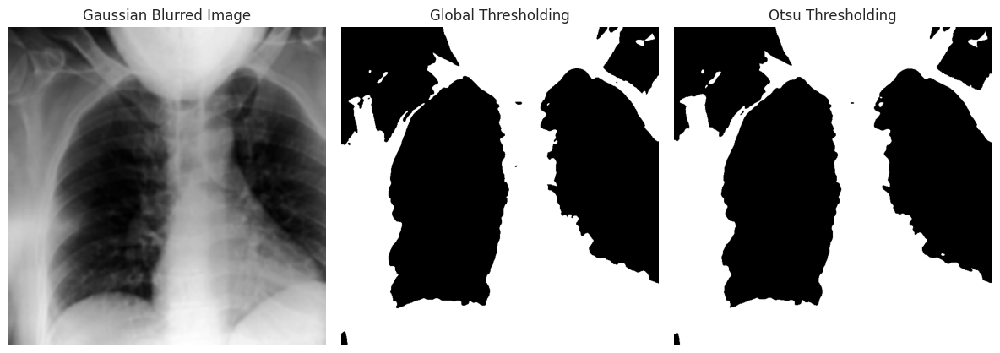

Number of connected components: 9


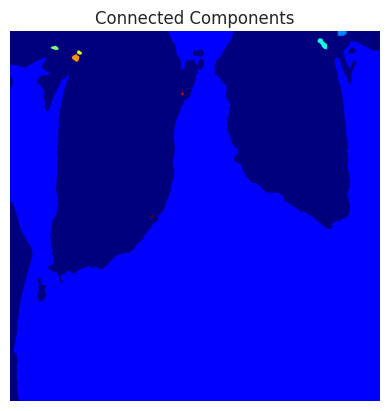

Label: 1
Centroid: (444.20406563785065, 368.887068530166)
Area: 304946.0
Bounding Box: (0, 0, 700, 700)
Perimeter: 5099.048086152251
Eccentricity: 0.5087999363771193
------------------------------
Label: 2
Centroid: (3.823943661971831, 627.4014084507043)
Area: 142.0
Bounding Box: (0, 620, 10, 637)
Perimeter: 45.89949493661166
Eccentricity: 0.8434878402169689
------------------------------
Label: 3
Centroid: (23.390862944162436, 591.1269035532995)
Area: 197.0
Bounding Box: (14, 582, 35, 600)
Perimeter: 60.526911934581186
Eccentricity: 0.9253010973250352
------------------------------
Label: 4
Centroid: (31.65, 84.6125)
Area: 80.0
Bounding Box: (28, 77, 36, 92)
Perimeter: 34.97056274847714
Eccentricity: 0.8673093727786467
------------------------------
Label: 5
Centroid: (40.50909090909091, 130.83636363636364)
Area: 55.0
Bounding Box: (37, 127, 45, 136)
Perimeter: 25.899494936611667
Eccentricity: 0.7235367234237243
------------------------------
Label: 6
Centroid: (50.48888888888889, 124

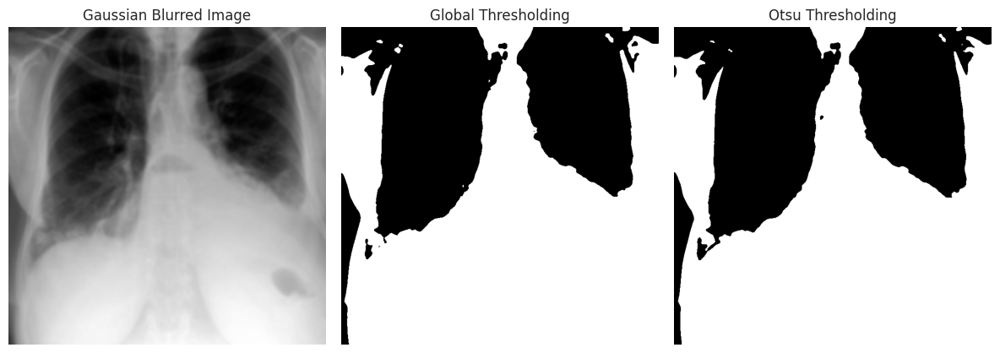

Number of connected components: 11


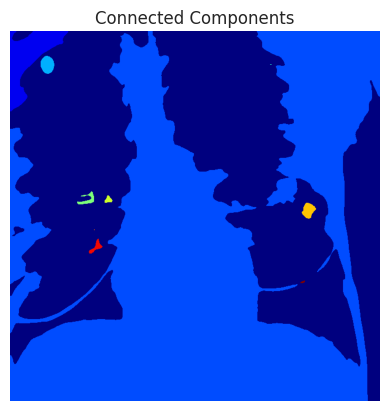

Label: 1
Centroid: (52.24880095923261, 34.46297961630695)
Area: 6672.0
Bounding Box: (0, 0, 152, 110)
Perimeter: 524.3330444827409
Eccentricity: 0.9008707335623841
------------------------------
Label: 2
Centroid: (416.3894272952062, 366.71020180266413)
Area: 250740.0
Bounding Box: (0, 0, 700, 700)
Perimeter: 7009.519441114115
Eccentricity: 0.7046441738563394
------------------------------
Label: 3
Centroid: (63.403534609720175, 70.36082474226804)
Area: 679.0
Bounding Box: (47, 58, 81, 84)
Perimeter: 96.08326112068522
Eccentricity: 0.6469872208594386
------------------------------
Label: 4
Centroid: (63.0, 493.0)
Area: 3.0
Bounding Box: (63, 492, 64, 495)
Perimeter: 1.0
Eccentricity: 1.0
------------------------------
Label: 5
Centroid: (318.13398692810455, 146.51307189542484)
Area: 306.0
Bounding Box: (303, 127, 328, 159)
Perimeter: 129.2193000900063
Eccentricity: 0.840652002212902
------------------------------
Label: 6
Centroid: (318.7218045112782, 185.70676691729324)
Area: 133.0
Bo

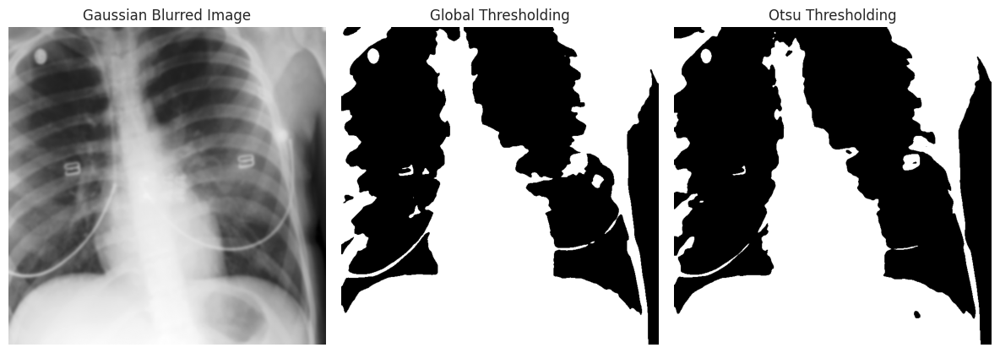

Number of connected components: 7


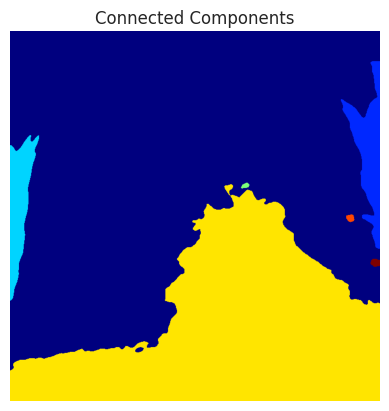

Label: 1
Centroid: (225.9501033362858, 679.149493160122)
Area: 10161.0
Bounding Box: (57, 626, 412, 700)
Perimeter: 914.6589462905454
Eccentricity: 0.9802925414930103
------------------------------
Label: 2
Centroid: (324.51005083179297, 17.318853974121996)
Area: 8656.0
Bounding Box: (197, 0, 510, 55)
Perimeter: 726.1848122046001
Eccentricity: 0.9910525533010184
------------------------------
Label: 3
Centroid: (292.2118644067797, 444.8305084745763)
Area: 118.0
Bounding Box: (287, 437, 298, 453)
Perimeter: 41.79898987322333
Eccentricity: 0.8363050213284123
------------------------------
Label: 4
Centroid: (561.9538720334002, 421.8098268512326)
Area: 148023.0
Bounding Box: (290, 0, 700, 700)
Perimeter: 2338.035713374682
Eccentricity: 0.8146970528272727
------------------------------
Label: 5
Centroid: (353.5287356321839, 643.5114942528736)
Area: 174.0
Bounding Box: (347, 636, 362, 652)
Perimeter: 49.21320343559643
Eccentricity: 0.48342263540121266
------------------------------
Label: 6

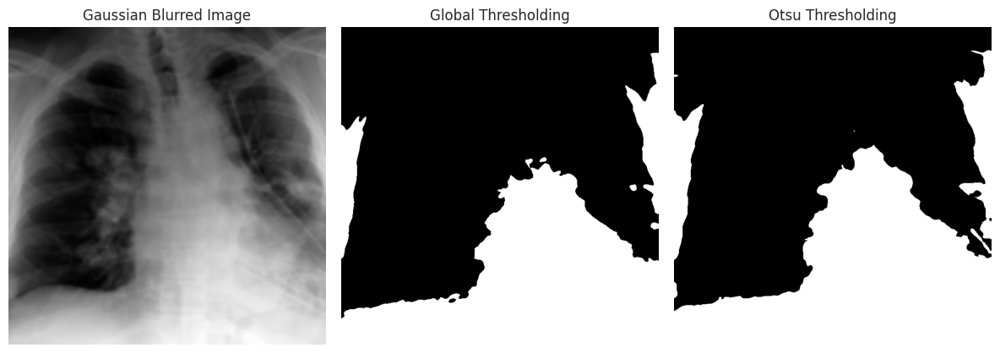

Number of connected components: 19


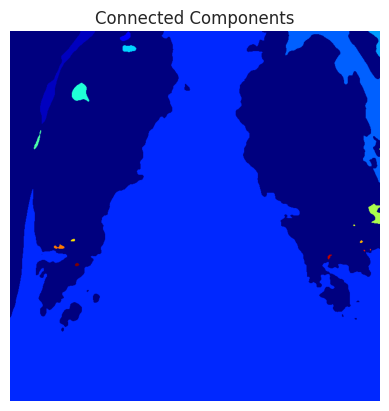

Label: 1
Centroid: (79.00858704137393, 96.96409055425448)
Area: 2562.0
Bounding Box: (0, 57, 176, 161)
Perimeter: 457.48737341529164
Eccentricity: 0.9934422054292519
------------------------------
Label: 2
Centroid: (10.733333333333333, 218.56666666666666)
Area: 210.0
Bounding Box: (1, 208, 19, 228)
Perimeter: 58.526911934581186
Eccentricity: 0.8663214522734711
------------------------------
Label: 3
Centroid: (459.40225456725324, 353.4686195527418)
Area: 273578.0
Bounding Box: (0, 0, 700, 700)
Perimeter: 4486.646065898698
Eccentricity: 0.3715325503847403
------------------------------
Label: 4
Centroid: (94.25272527252726, 645.1435143514351)
Area: 9999.0
Bounding Box: (0, 521, 287, 700)
Perimeter: 1082.642748368369
Eccentricity: 0.9365151692020487
------------------------------
Label: 5
Centroid: (18.053619302949063, 694.0670241286863)
Area: 373.0
Bounding Box: (0, 678, 49, 700)
Perimeter: 133.01219330881975
Eccentricity: 0.9639523249743924
------------------------------
Label: 6
Cent

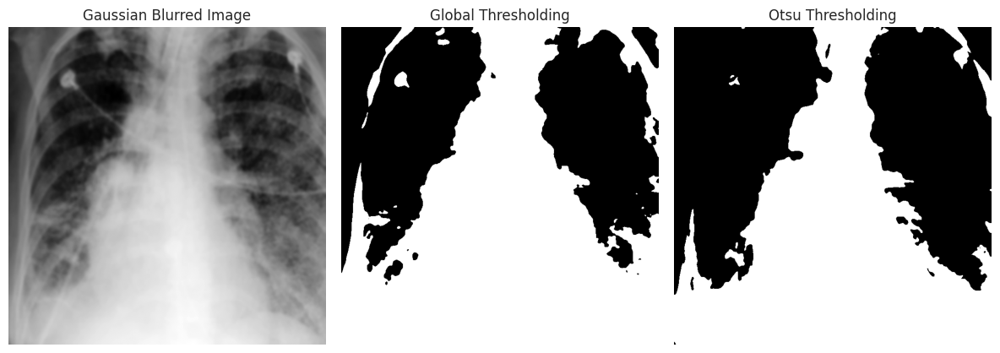

In [23]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from skimage.measure import regionprops

# Otsu Thresholding fonksiyonu
def otsu_thresholding(img):
    _, otsu_thresh_img = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    return otsu_thresh_img

# Global Thresholding fonksiyonu
def global_thresholding(img, threshold_value=127):
    _, global_thresh_img = cv2.threshold(img, threshold_value, 255, cv2.THRESH_BINARY)
    return global_thresh_img

# Görüntüyü kırpma fonksiyonu
def crop_lung_region(image_path, output_size=(700, 700)):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    img_eq = cv2.equalizeHist(img)
    h, w = img_eq.shape
    crop_w = output_size[0]
    crop_h = output_size[1]
    start_x = (w - crop_w) // 2
    start_y = (h - crop_h) // 2
    cropped_img = img_eq[start_y:start_y+crop_h, start_x:start_x+crop_w]
    resized_cropped_img = cv2.resize(cropped_img, output_size)
    blurred_img = cv2.GaussianBlur(resized_cropped_img, (15, 15), 0)
    global_thresh_img = global_thresholding(blurred_img)
    otsu_thresh_img = otsu_thresholding(blurred_img)
    resized_img = cv2.resize(img_eq, output_size)
    return resized_img, blurred_img, global_thresh_img, otsu_thresh_img

# Morfolojik Operatörler fonksiyonu
def apply_morphological_operations(thresh_img):
    kernel = np.ones((3, 3), np.uint8)
    opened_img = cv2.morphologyEx(thresh_img, cv2.MORPH_OPEN, kernel)
    closed_img = cv2.morphologyEx(thresh_img, cv2.MORPH_CLOSE, kernel)
    return opened_img, closed_img

# Bağlantı Bileşen Analizi (CCL) fonksiyonu
def connected_component_labeling(thresh_img):
    num_labels, labels = cv2.connectedComponents(thresh_img)
    print(f"Number of connected components: {num_labels}")
    plt.imshow(labels, cmap='jet')
    plt.title("Connected Components")
    plt.axis('off')
    plt.show()
    return num_labels, labels

# Öznitelik Çıkarma fonksiyonu
def extract_region_properties(labels):
    props = regionprops(labels)
    for prop in props:
        print(f"Label: {prop.label}")
        print(f"Centroid: {prop.centroid}")
        print(f"Area: {prop.area}")
        print(f"Bounding Box: {prop.bbox}")
        print(f"Perimeter: {prop.perimeter}")
        print(f"Eccentricity: {prop.eccentricity}")
        print("-" * 30)
    return props

# Filtreleme (Alanı büyük olanları seçme) fonksiyonu
def filter_by_area(props):
    sorted_props = sorted(props, key=lambda x: x.area, reverse=True)
    top_two = sorted_props[:2]
    for prop in top_two:
        print(f"Selected Region: {prop.label}, Area: {prop.area}")
    return top_two

# Görselleri yan yana göstermek için fonksiyon
def plot_images(blurred_img, global_thresh_img, otsu_thresh_img):
    fig, ax = plt.subplots(1, 3, figsize=(12, 5))
    ax[0].imshow(blurred_img, cmap='gray')
    ax[0].set_title("Gaussian Blurred Image")
    ax[0].axis('off')
    ax[1].imshow(global_thresh_img, cmap='gray')
    ax[1].set_title("Global Thresholding")
    ax[1].axis('off')
    ax[2].imshow(otsu_thresh_img, cmap='gray')
    ax[2].set_title("Otsu Thresholding")
    ax[2].axis('off')
    plt.tight_layout()
    plt.show()

# Görüntülerin bulunduğu klasör
img_dir = 'nih/images_small/'

# PNG formatındaki görselleri yükleme
image_files = [f for f in os.listdir(img_dir) if f.endswith('.png')]

# Yeterince görsel olup olmadığını kontrol et
if len(image_files) < 9:
    print(f"Yeterli görsel bulunamadı. Bulunan görsel sayısı: {len(image_files)}")
else:
    random_images = np.random.choice(image_files, 9, replace=False)

    # Her bir rastgele görseli işleyip sonuçları göster
    for img_name in random_images:
        img_path = os.path.join(img_dir, img_name)
        original_img, blurred_img, global_thresh_img, otsu_thresh_img = crop_lung_region(img_path)

        # Threshold edilmiş görseller üzerine morfolojik işlemleri uygulama
        opened_img, closed_img = apply_morphological_operations(global_thresh_img)

        # Bağlantı bileşen analizi
        num_labels, labels = connected_component_labeling(global_thresh_img)

        # Bölge özniteliklerini çıkarma
        props = extract_region_properties(labels)

        # Alanına göre filtreleme yapma
        top_two = filter_by_area(props)

        # Filtrelenmiş görsel üzerinde morfolojik işlemleri uygulama
        # Örneğin, en büyük iki bölgeyi seçtikten sonra dilatasyon uygulama
        kernel = np.ones((5, 5), np.uint8)
        dilated_img = cv2.dilate(global_thresh_img, kernel, iterations=2)

        # Görselleri yan yana göster
        plot_images(blurred_img, global_thresh_img, otsu_thresh_img)

Number of connected components: 5


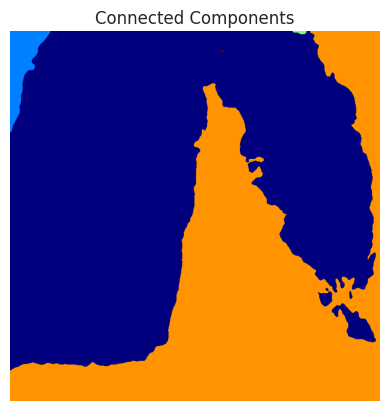

Label: 1
Centroid: (62.86698488464598, 21.935083532219572)
Area: 6285.0
Bounding Box: (0, 0, 191, 76)
Perimeter: 499.72287142747456
Eccentricity: 0.9582133672690403
------------------------------
Label: 2
Centroid: (1.8928571428571428, 549.2946428571429)
Area: 112.0
Bounding Box: (0, 535, 6, 561)
Perimeter: 54.69238815542512
Eccentricity: 0.9756620652806525
------------------------------
Label: 3
Centroid: (477.4484637445979, 452.96761833927775)
Area: 177477.0
Bounding Box: (0, 0, 700, 700)
Perimeter: 4462.656167166464
Eccentricity: 0.7588937239533547
------------------------------
Label: 4
Centroid: (37.63636363636363, 400.8181818181818)
Area: 11.0
Bounding Box: (36, 399, 40, 403)
Perimeter: 10.035533905932738
Eccentricity: 0.8337788470424282
------------------------------
Selected Region: 3, Area: 177477.0
Selected Region: 1, Area: 6285.0


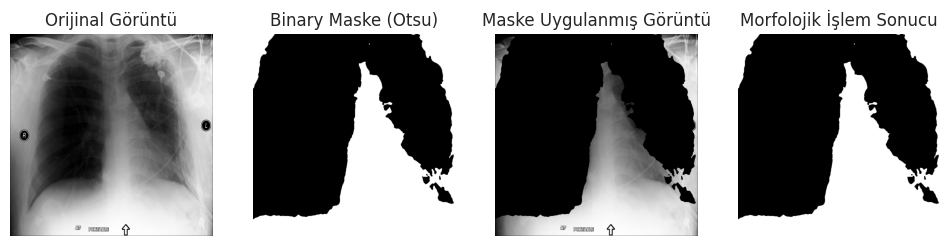

Number of connected components: 8


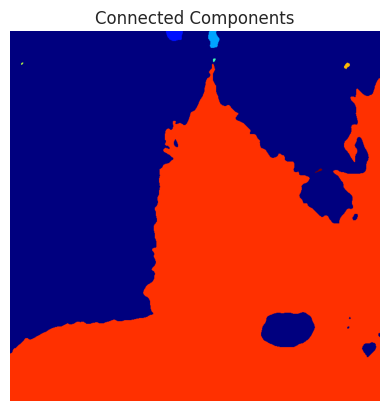

Label: 1
Centroid: (7.82897384305835, 311.03420523138834)
Area: 497.0
Bounding Box: (0, 295, 19, 327)
Perimeter: 89.79898987322332
Eccentricity: 0.7830319036628962
------------------------------
Label: 2
Centroid: (15.049212598425196, 384.61417322834643)
Area: 508.0
Bounding Box: (0, 375, 32, 397)
Perimeter: 93.73401871576773
Eccentricity: 0.8265805441645623
------------------------------
Label: 3
Centroid: (54.46153846153846, 385.7692307692308)
Area: 26.0
Bounding Box: (52, 384, 59, 389)
Perimeter: 17.071067811865476
Eccentricity: 0.7856947785999672
------------------------------
Label: 4
Centroid: (61.15384615384615, 22.46153846153846)
Area: 13.0
Bounding Box: (59, 21, 64, 25)
Perimeter: 11.449747468305832
Eccentricity: 0.8693516076357529
------------------------------
Label: 5
Centroid: (65.18072289156626, 636.8915662650602)
Area: 83.0
Bounding Box: (60, 632, 72, 643)
Perimeter: 33.798989873223334
Eccentricity: 0.8044108878935409
------------------------------
Label: 6
Centroid: (47

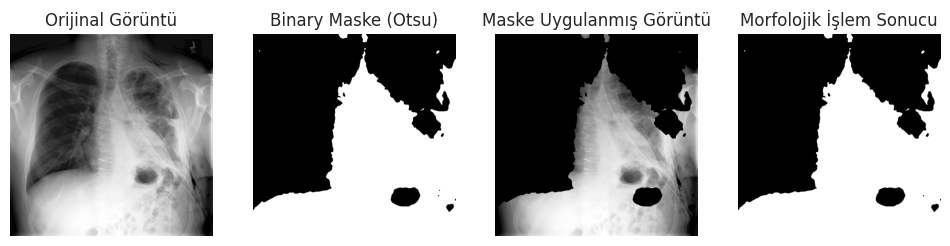

Number of connected components: 16


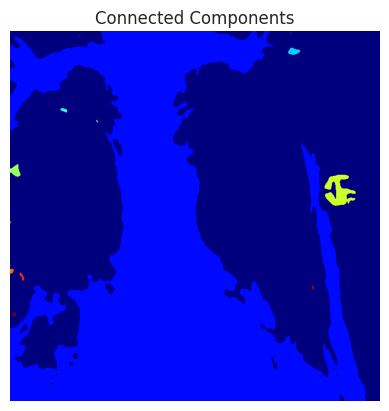

Label: 1
Centroid: (3.0, 0.7857142857142857)
Area: 14.0
Bounding Box: (0, 0, 6, 3)
Perimeter: 11.414213562373096
Eccentricity: 0.8951262378886442
------------------------------
Label: 2
Centroid: (420.2158646740023, 301.4123407549914)
Area: 213115.0
Bounding Box: (0, 0, 700, 674)
Perimeter: 6436.346822218335
Eccentricity: 0.7755999288454819
------------------------------
Label: 3
Centroid: (1.5, 531.0)
Area: 4.0
Bounding Box: (0, 531, 4, 532)
Perimeter: 2.0
Eccentricity: 1.0
------------------------------
Label: 4
Centroid: (9.0, 131.5)
Area: 2.0
Bounding Box: (9, 131, 10, 133)
Perimeter: 0.0
Eccentricity: 1.0
------------------------------
Label: 5
Centroid: (38.21052631578947, 536.1913875598086)
Area: 209.0
Bounding Box: (31, 526, 45, 549)
Perimeter: 58.8700576850888
Eccentricity: 0.8330279269279902
------------------------------
Label: 6
Centroid: (149.2, 101.67142857142858)
Area: 70.0
Bounding Box: (146, 95, 154, 108)
Perimeter: 32.72792206135785
Eccentricity: 0.8942097991488824
--

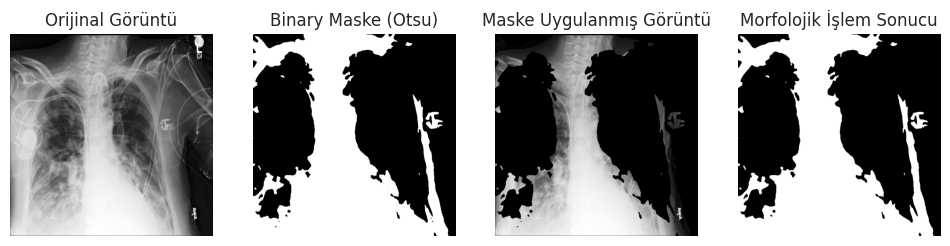

Number of connected components: 7


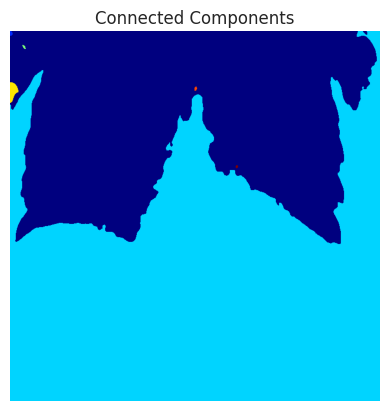

Label: 1
Centroid: (4.135135135135135, 1.6486486486486487)
Area: 37.0
Bounding Box: (0, 0, 9, 5)
Perimeter: 21.65685424949238
Eccentricity: 0.8353893781530909
------------------------------
Label: 2
Centroid: (478.2537774689662, 365.6921125134385)
Area: 289281.0
Bounding Box: (0, 0, 700, 700)
Perimeter: 4358.5241328105
Eccentricity: 0.7275492504520574
------------------------------
Label: 3
Centroid: (29.724137931034484, 26.20689655172414)
Area: 29.0
Bounding Box: (26, 23, 34, 30)
Perimeter: 20.727922061357855
Eccentricity: 0.9107733713365642
------------------------------
Label: 4
Centroid: (113.14102564102564, 5.37948717948718)
Area: 390.0
Bounding Box: (97, 0, 136, 16)
Perimeter: 93.69848480983498
Eccentricity: 0.9102511712335207
------------------------------
Label: 5
Centroid: (108.64516129032258, 350.80645161290323)
Area: 31.0
Bounding Box: (105, 349, 113, 354)
Perimeter: 19.071067811865476
Eccentricity: 0.8194837662533475
------------------------------
Label: 6
Centroid: (256.23

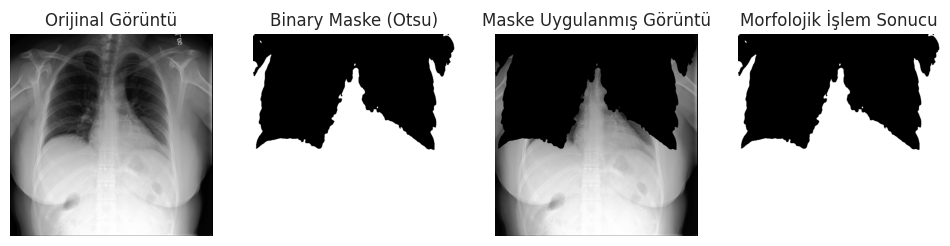

Number of connected components: 12


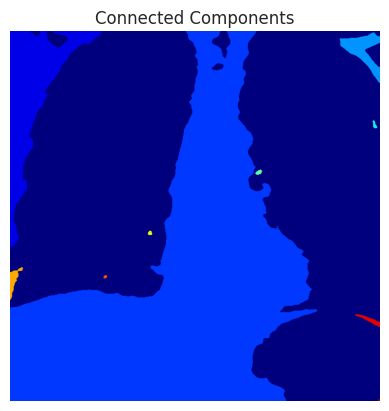

Label: 1
Centroid: (122.22769830331258, 41.53856755857611)
Area: 21041.0
Bounding Box: (0, 0, 409, 172)
Perimeter: 1214.0386719675123
Eccentricity: 0.9558666403768112
------------------------------
Label: 2
Centroid: (469.8406933737356, 319.3681598413618)
Area: 179528.0
Bounding Box: (0, 0, 700, 581)
Perimeter: 3072.5474734076133
Eccentricity: 0.8051977712880937
------------------------------
Label: 3
Centroid: (36.39114917915774, 667.8868665239115)
Area: 2802.0
Bounding Box: (3, 624, 98, 700)
Perimeter: 325.4629867976521
Eccentricity: 0.7787380305394609
------------------------------
Label: 4
Centroid: (177.05194805194805, 689.3506493506494)
Area: 77.0
Bounding Box: (169, 686, 184, 695)
Perimeter: 37.55634918610404
Eccentricity: 0.9287480434131432
------------------------------
Label: 5
Centroid: (266.9166666666667, 470.3095238095238)
Area: 84.0
Bounding Box: (262, 464, 272, 477)
Perimeter: 33.798989873223334
Eccentricity: 0.8188339187827198
------------------------------
Label: 6
Cen

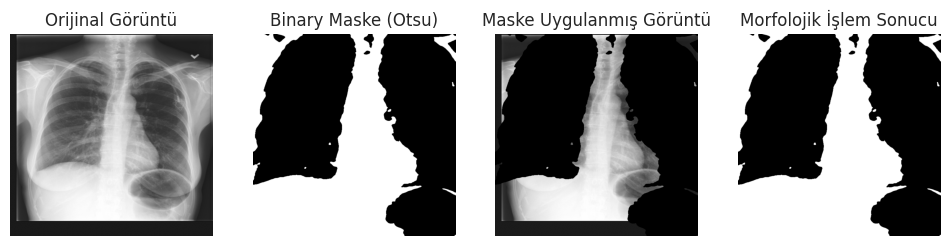

Number of connected components: 15


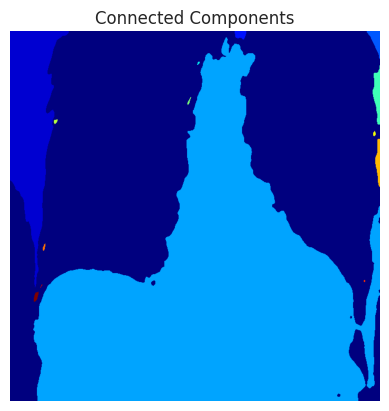

Label: 1
Centroid: (167.96250526074147, 39.256188544974556)
Area: 26137.0
Bounding Box: (0, 0, 485, 111)
Perimeter: 1185.9665581351203
Eccentricity: 0.9792583461606192
------------------------------
Label: 2
Centroid: (6.164285714285715, 435.62857142857143)
Area: 280.0
Bounding Box: (0, 425, 16, 447)
Perimeter: 67.55634918610404
Eccentricity: 0.7278274989538521
------------------------------
Label: 3
Centroid: (16.233057851239668, 691.4314049586777)
Area: 605.0
Bounding Box: (0, 675, 53, 700)
Perimeter: 134.31980515339464
Eccentricity: 0.9262378887565611
------------------------------
Label: 4
Centroid: (493.6158266218146, 381.9934908737304)
Area: 214929.0
Bounding Box: (12, 44, 700, 700)
Perimeter: 3460.843937963895
Eccentricity: 0.4690443794138709
------------------------------
Label: 5
Centroid: (60.26315789473684, 356.05263157894734)
Area: 19.0
Bounding Box: (58, 354, 64, 359)
Perimeter: 13.65685424949238
Eccentricity: 0.8894915358514988
------------------------------
Label: 6
Cent

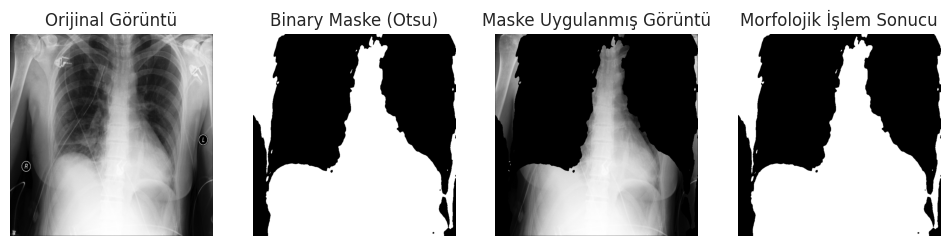

Number of connected components: 15


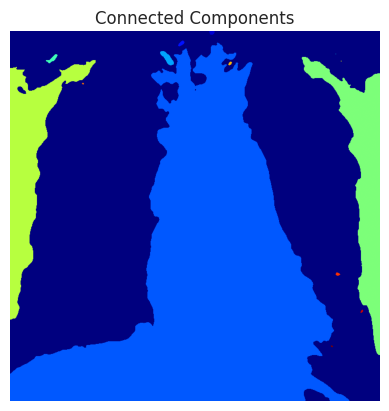

Label: 1
Centroid: (2.65, 381.53333333333336)
Area: 60.0
Bounding Box: (0, 377, 7, 387)
Perimeter: 27.65685424949238
Eccentricity: 0.6807641043293733
------------------------------
Label: 2
Centroid: (23.173333333333332, 323.73333333333335)
Area: 75.0
Bounding Box: (18, 318, 29, 330)
Perimeter: 33.21320343559643
Eccentricity: 0.8832393242956553
------------------------------
Label: 3
Centroid: (457.55914863153845, 367.8946634540899)
Area: 187181.0
Bounding Box: (22, 0, 700, 642)
Perimeter: 3236.2358569496814
Eccentricity: 0.7646280459159656
------------------------------
Label: 4
Centroid: (50.78915662650602, 297.1656626506024)
Area: 332.0
Bounding Box: (38, 284, 65, 310)
Perimeter: 81.49747468305833
Eccentricity: 0.942906826830734
------------------------------
Label: 5
Centroid: (43.0, 616.0)
Area: 1.0
Bounding Box: (43, 616, 44, 617)
Perimeter: 0.0
Eccentricity: 0
------------------------------
Label: 6
Centroid: (52.416666666666664, 79.70138888888889)
Area: 144.0
Bounding Box: (44,

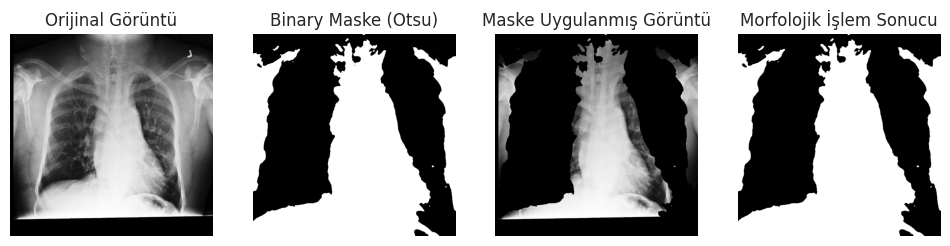

Number of connected components: 12


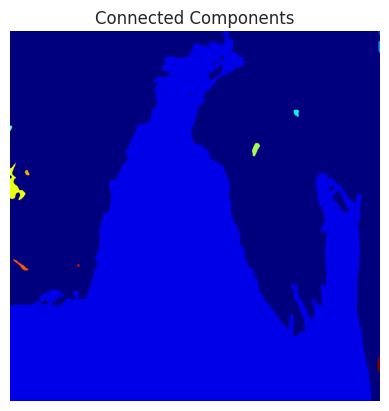

Label: 1
Centroid: (480.3976562836586, 339.8703330317522)
Area: 232110.0
Bounding Box: (0, 0, 700, 684)
Perimeter: 4214.154687870049
Eccentricity: 0.16757511438141034
------------------------------
Label: 2
Centroid: (3.142857142857143, 698.1428571428571)
Area: 21.0
Bounding Box: (0, 697, 8, 700)
Perimeter: 16.207106781186546
Eccentricity: 0.9413939019495813
------------------------------
Label: 3
Centroid: (29.0327868852459, 698.0655737704918)
Area: 61.0
Bounding Box: (19, 697, 41, 700)
Perimeter: 42.828427124746185
Eccentricity: 0.9907600068861288
------------------------------
Label: 4
Centroid: (154.3, 541.56)
Area: 100.0
Bounding Box: (149, 537, 163, 547)
Perimeter: 37.55634918610404
Eccentricity: 0.7387031990150665
------------------------------
Label: 5
Centroid: (182.73333333333332, 1.1666666666666667)
Area: 30.0
Bounding Box: (179, 0, 189, 4)
Perimeter: 20.242640687119284
Eccentricity: 0.9226254363205584
------------------------------
Label: 6
Centroid: (222.78636363636363, 46

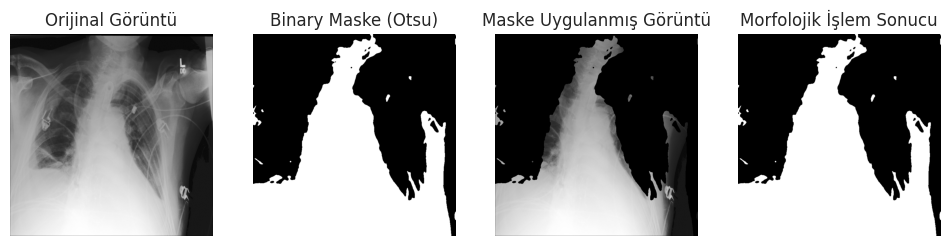

Number of connected components: 20


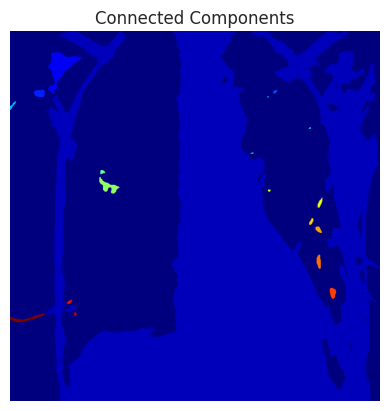

Label: 1
Centroid: (416.19332950641757, 426.25018611367733)
Area: 222982.0
Bounding Box: (0, 67, 700, 700)
Perimeter: 7662.552016427217
Eccentricity: 0.6535562850376434
------------------------------
Label: 2
Centroid: (67.73142857142857, 94.74077922077922)
Area: 1925.0
Bounding Box: (40, 72, 119, 135)
Perimeter: 263.07821048680194
Eccentricity: 0.818074133388252
------------------------------
Label: 3
Centroid: (117.52765957446809, 55.65106382978723)
Area: 235.0
Bounding Box: (111, 45, 126, 66)
Perimeter: 59.21320343559643
Eccentricity: 0.7462706388911623
------------------------------
Label: 4
Centroid: (114.51515151515152, 500.969696969697)
Area: 33.0
Bounding Box: (112, 498, 119, 506)
Perimeter: 21.106601717798213
Eccentricity: 0.8595544712943907
------------------------------
Label: 5
Centroid: (124.11111111111111, 487.55555555555554)
Area: 9.0
Bounding Box: (123, 486, 126, 490)
Perimeter: 7.621320343559642
Eccentricity: 0.8606629658238704
------------------------------
Label: 6
C

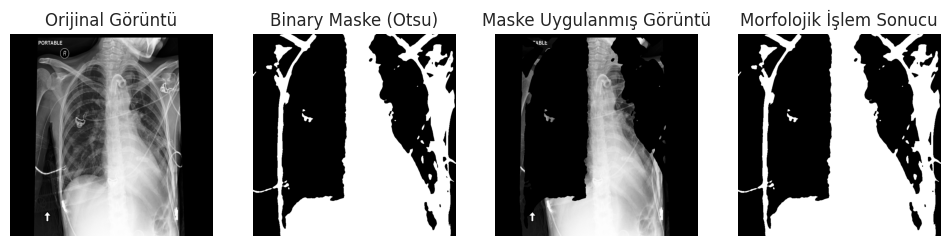

In [32]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from skimage.measure import regionprops

# Maske ile orijinal görüntüyü çarpma fonksiyonu
def apply_mask(original_img, binary_mask):
    return cv2.bitwise_and(original_img, original_img, mask=binary_mask)

# Görüntülerin bulunduğu klasör
img_dir = 'nih/images_small/'

# PNG formatındaki görselleri yükleme
image_files = [f for f in os.listdir(img_dir) if f.endswith('.png')]

# Yeterince görsel olup olmadığını kontrol et
if len(image_files) < 9:
    print(f"Yeterli görsel bulunamadı. Bulunan görsel sayısı: {len(image_files)}")
else:
    random_images = np.random.choice(image_files, 9, replace=False)

    # Her bir rastgele görseli işleyip sonuçları göster
    for img_name in random_images:
        img_path = os.path.join(img_dir, img_name)
        original_img, blurred_img, global_thresh_img, otsu_thresh_img = crop_lung_region(img_path)

        # Threshold edilmiş görseller üzerine morfolojik işlemleri uygulama
        opened_img, closed_img = apply_morphological_operations(otsu_thresh_img)

        # Bağlantı bileşen analizi
        num_labels, labels = connected_component_labeling(otsu_thresh_img)

        # Bölge özniteliklerini çıkarma
        props = extract_region_properties(labels)

        # Alanına göre filtreleme yapma
        top_two = filter_by_area(props)

        # Maske ile orijinal görüntüyü çarp
        masked_img = apply_mask(original_img, otsu_thresh_img)

        # Görselleri yan yana göster
        plt.figure(figsize=(12, 6))

        plt.subplot(1, 4, 1)
        plt.imshow(original_img, cmap='gray')
        plt.title("Orijinal Görüntü")
        plt.axis("off")

        plt.subplot(1, 4, 2)
        plt.imshow(otsu_thresh_img, cmap='gray')
        plt.title("Binary Maske (Otsu)")
        plt.axis("off")

        plt.subplot(1, 4, 3)
        plt.imshow(masked_img, cmap='gray')
        plt.title("Maske Uygulanmış Görüntü")
        plt.axis("off")

        plt.subplot(1, 4, 4)
        plt.imshow(closed_img, cmap='gray')
        plt.title("Morfolojik İşlem Sonucu")
        plt.axis("off")

        plt.show()


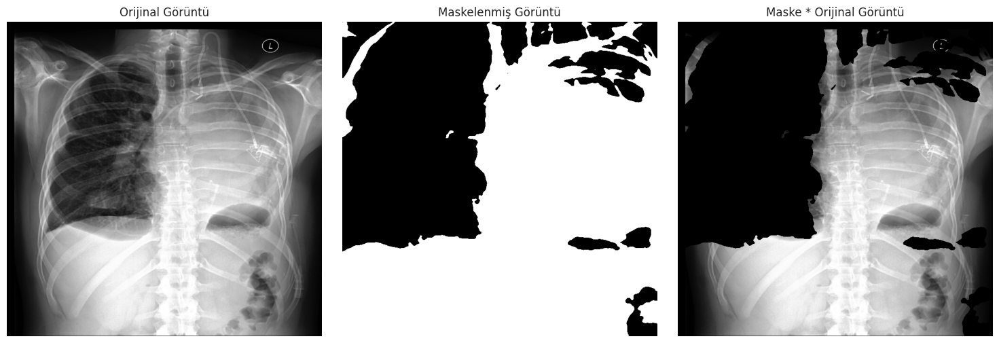

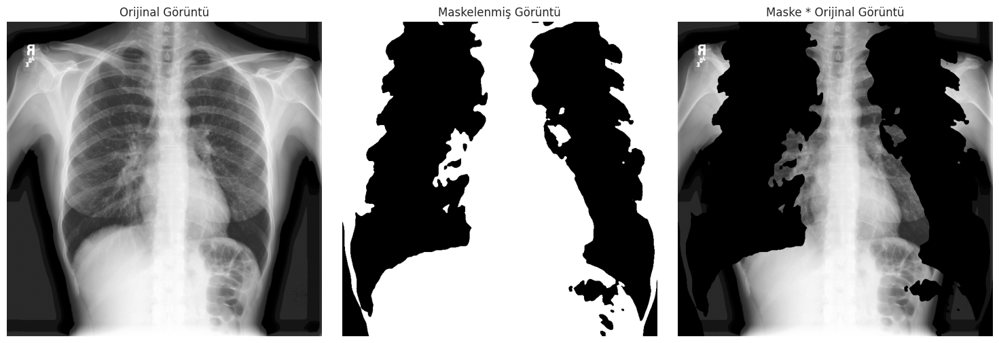

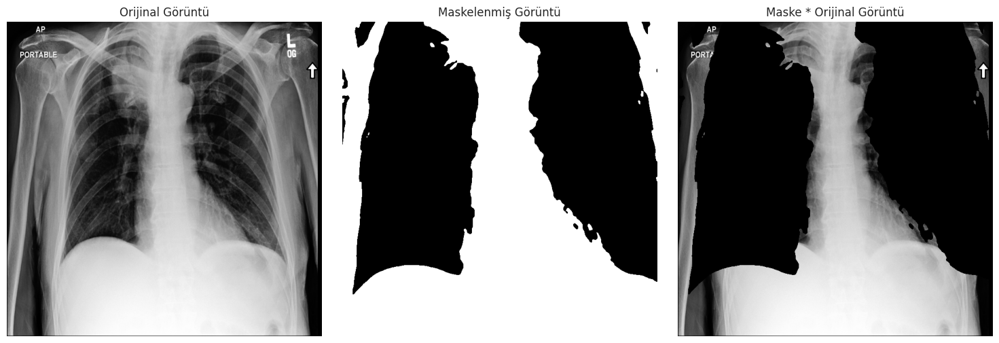

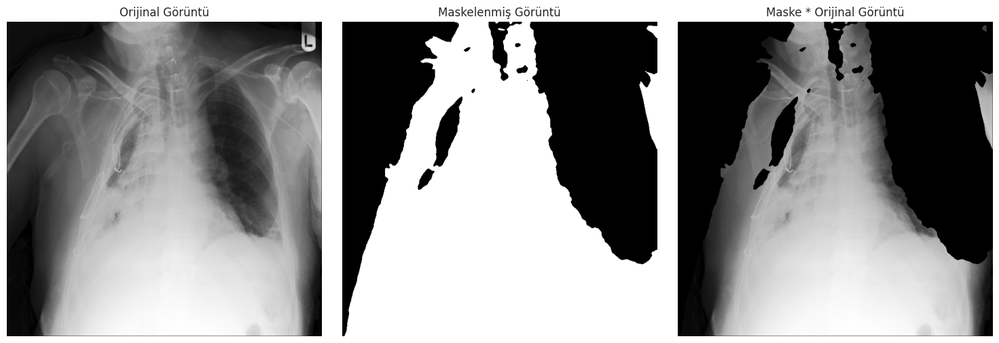

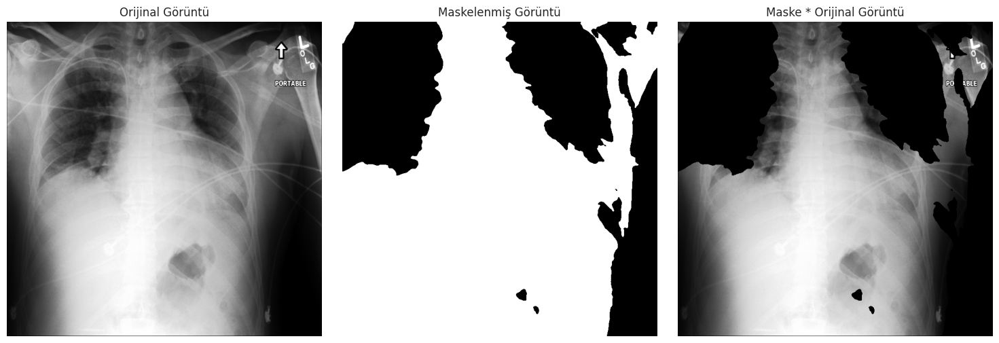

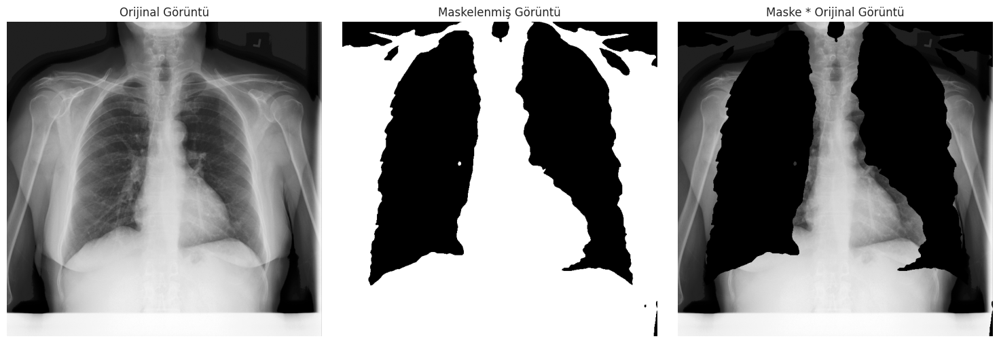

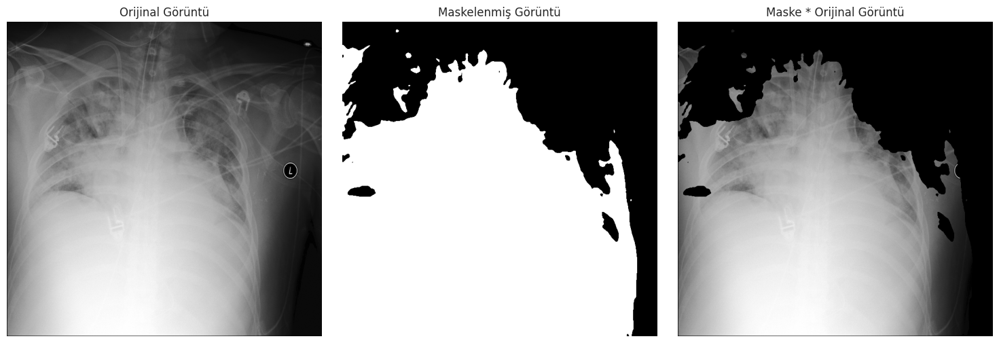

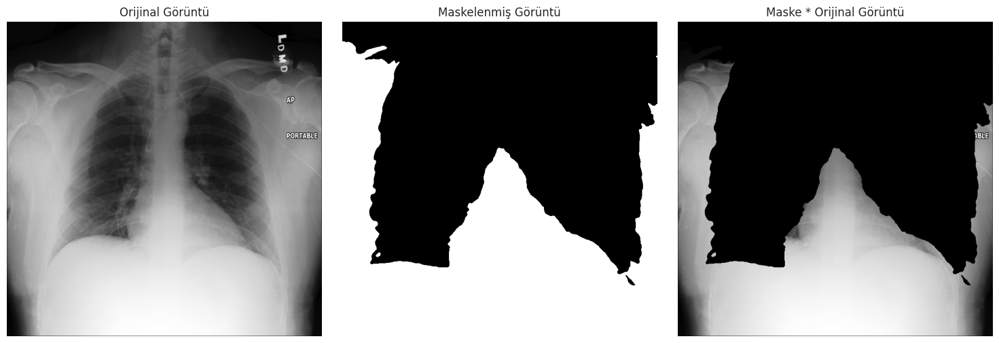

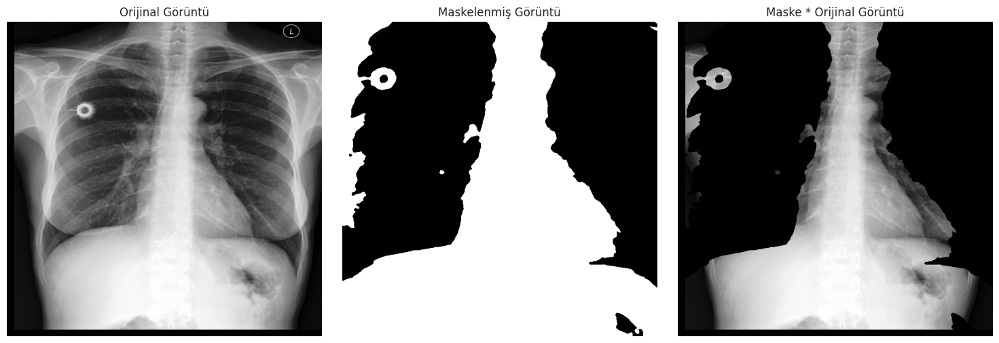

In [33]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Maskelenmiş görüntüyü oluşturup görselleştiren fonksiyon
def apply_mask_and_plot(original_img, global_thresh_img, img_name):
    # Maskeyi uygula (Pixel-wise çarpma işlemi)
    masked_image = original_img * (global_thresh_img / 255)

    # Sonuçları göster
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    ax[0].imshow(original_img, cmap='gray')
    ax[0].set_title("Orijinal Görüntü")
    ax[0].axis('off')

    ax[1].imshow(global_thresh_img, cmap='gray')
    ax[1].set_title("Maskelenmiş Görüntü")
    ax[1].axis('off')

    ax[2].imshow(masked_image, cmap='gray')
    ax[2].set_title("Maske * Orijinal Görüntü")
    ax[2].axis('off')

    plt.tight_layout()
    plt.show()

# Görüntülerin bulunduğu klasör
img_dir = 'nih/images_small/'

# PNG formatındaki görselleri yükleme
image_files = [f for f in os.listdir(img_dir) if f.endswith('.png')]

# Yalnızca 9 görseli al
image_files = image_files[:9]

# Görselleri sırayla işle
if len(image_files) == 0:
    print("Görsel bulunamadı.")
else:
    for img_name in image_files:
        img_path = os.path.join(img_dir, img_name)

        # Görüntüyü işle
        original_img, blurred_img, global_thresh_img, otsu_thresh_img = crop_lung_region(img_path)

        # Maskeyi uygula ve sonucu göster
        apply_mask_and_plot(original_img, global_thresh_img, img_name)